<a href="https://colab.research.google.com/github/MoustafaRYehia/fraud-project-cafc/blob/main/Canadian_CAFC_Fraud_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. DATA DOWNLOAD, CLEANING, PROFILING

## Data Source

Data used in this project comes from the **Canadian Anti-Fraud Centre (CAFC) Fraud Reporting System**,  
a public dataset published on the Government of Canada Open Data portal.  

- Dataset: [Fraud Reporting System (2021–2025)](https://open.canada.ca/data/en/dataset/6a09c998-cddb-4a22-beff-4dca67ab892f)  
- Metadata / Definitions: [CAFC Dataset Dictionary](https://open.canada.ca/data/en/dataset/6a09c998-cddb-4a22-beff-4dca67ab892f/resource/ec49223e-d746-4171-a97b-12fcc79d360f)  
- Format: CSV (70.8 MB), available in English and French  
- Last Updated: April 1, 2025  


In [ ]:
############################################################
# CAFC – Load & Clean Data : Remove french duplicates, parse dollar loss
############################################################

# ---------- 2. Load data and Pre-clean ----------
df = pd.read_csv(output_csv, low_memory=False)
print(f"✔️  Loaded shape: {df.shape}")

# Drop French‐named duplicates (to avoid from the beginning):
df.drop(columns=[
    "Type de plainte reçue",
    "Pays",
    "Province/État",
    "Catégories thématiques sur la fraude et la cybercriminalité",
    "Méthode de sollicitation",
    "Genre",
    "Langue de correspondance",
    "Type de plainte"
], inplace=True)


print("Dropped French duplicate columns.  Remaining cols:", df.columns.tolist())


# 1. Add Clean “Dollar Loss” column (originally named "Dollar Loss /pertes financières")
df['Dollar Loss'] = (
    df['Dollar Loss /pertes financières']
      .astype(str)                             # ensure string
      .str.replace(r'[\$,]', '', regex=True)   # drop $ and commas
      .replace('', pd.NA)                      # turn empty strings into NA
      .astype(float)                           # cast to float
)

# 2. Remove the old mixed-name column "Dollar Loss /pertes financières"
df.drop(columns=['Dollar Loss /pertes financières'], inplace=True)

# 3. Quick check
print("Dollar Loss dtype:", df['Dollar Loss'].dtype)
print("Sample values:\n", df['Dollar Loss'].head())



✔️  Loaded shape: (328649, 21)
Dropped French duplicate columns.  Remaining cols: ["Numéro d'identification / Number ID", 'Date Received / Date reçue', 'Complaint Received Type', 'Country', 'Province/State', 'Fraud and Cybercrime Thematic Categories', 'Solicitation Method', 'Gender', 'Language of Correspondence', "Victim Age Range / Tranche d'âge des victimes", 'Complaint Type', 'Number of Victims / Nombre de victimes', 'Dollar Loss /pertes financières']
Dollar Loss dtype: float64
Sample values:
 0       0.00
1    1000.00
2       0.00
3       0.00
4     222.73
Name: Dollar Loss, dtype: float64


In [ ]:
############################################################
# === Verification: Dollar Loss cleaning ===
############################################################

import random
import pandas as pd

# 1. Check dtype & missing count
print("Post-clean dtype:   ", df['Dollar Loss'].dtype)
print("Missing values:     ", df['Dollar Loss'].isna().sum(), "of", len(df))

# 2. Summary statistics
print("\nSummary stats:")
print(df['Dollar Loss'].describe())

# 3. Spot-check original → cleaned mapping
orig = pd.read_csv(
    output_csv,
    usecols=['Dollar Loss /pertes financières'],
    low_memory=False
)
# parse raw to numeric
orig_numeric = (
    orig['Dollar Loss /pertes financières']
      .astype(str)
      .str.replace(r'[\$,]', '', regex=True)
      .replace('', pd.NA)
      .astype(float)
)

idx = random.sample(range(len(orig)), 20)
comparison = pd.DataFrame({
    'original_str':    orig['Dollar Loss /pertes financières'].iloc[idx].values,
    'cleaned_float':   df['Dollar Loss'].iloc[idx].values
})
print("\nRandom spot check (original → cleaned):")
display(comparison)

# 4. Percent non-zero check
orig_nonzero_pct   = orig_numeric.ne(0).mean() * 100
cleaned_nonzero_pct = df['Dollar Loss'].ne(0).mean() * 100
print(f"\n% non-zero in original (parsed): {orig_nonzero_pct:.2f}%")
print(f"% non-zero in cleaned:          {cleaned_nonzero_pct:.2f}%")

if abs(orig_nonzero_pct - cleaned_nonzero_pct) < 1e-6:
    print("✅ Percentages match – cleaning preserved non-zero distribution.")
else:
    print("⚠️  Percentages differ – investigate further.")


Post-clean dtype:    float64
Missing values:      0 of 328649

Summary stats:
count    3.286490e+05
mean     6.996873e+03
std      1.023280e+05
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      2.361500e+07
Name: Dollar Loss, dtype: float64

Random spot check (original → cleaned):


,original_str,cleaned_float
0,$330.00,330.0
1,$0.00,0.0
2,$0.00,0.0
3,$0.00,0.0
4,$0.00,0.0
5,$0.00,0.0
6,$0.00,0.0
7,$0.00,0.0
8,$0.00,0.0
9,$0.00,0.0



% non-zero in original (parsed): 24.48%
% non-zero in cleaned:          24.48%
✅ Percentages match – cleaning preserved non-zero distribution.


In [ ]:
############################################################
# === Convert “Date Received” to datetime ===
############################################################

df['Date Received'] = pd.to_datetime(
    df['Date Received / Date reçue'],
    errors='coerce'            # bad formats → NaT (should be none)
)

# Drop the original column and keep new datetime only
df.drop(columns=['Date Received / Date reçue'], inplace=True)

# Quick check
print("New dtype:", df['Date Received'].dtype)
print("Any NaT? ", df['Date Received'].isna().sum(), "of", len(df))
print("Sample dates:", df['Date Received'].head(5).to_list())


New dtype: datetime64[ns]
Any NaT?  0 of 328649
Sample dates: [Timestamp('2021-01-02 00:00:00'), Timestamp('2021-01-02 00:00:00'), Timestamp('2021-01-02 00:00:00'), Timestamp('2021-01-02 00:00:00'), Timestamp('2021-01-02 00:00:00')]


In [ ]:
############################################################
# === Parse Victim Age Range for EDA === age midpoint, low/high
############################################################

col = "Victim Age Range / Tranche d'âge des victimes"

# 1. Clean stray quotes/spaces
df[col] = df[col].str.replace("'", "", regex=False).str.strip()

# 2. Extract numeric bounds
bounds = df[col].str.extract(r'(?P<age_low>\d+)\s*-\s*(?P<age_high>\d+)').astype(float)

# 3. Midpoint
df['age_mid']  = bounds.mean(axis=1)

# 4. Keep low/high if you want
df['age_low']  = bounds['age_low']
df['age_high'] = bounds['age_high']

# 5. Quick sanity checks
print("Buckets:", df[col].nunique(), "unique (incl. NaN)")
print("age_mid dtype:", df['age_mid'].dtype,
      "  missing:", df['age_mid'].isna().sum())
print("Sample age_mid:", df['age_mid'].dropna().sample(5, random_state=1).tolist())


Buckets: 14 unique (incl. NaN)
age_mid dtype: float64   missing: 98368
Sample age_mid: [14.5, 24.5, 74.5, 64.5, 64.5]


In [ ]:
############################################################
# === Sanity check after Victim Age parsing (low, mid, high) ===
############################################################

import random
import pandas as pd

col = "Victim Age Range / Tranche d'âge des victimes"

# 1. Reload raw bucket
orig = pd.read_csv(output_csv, usecols=[col], low_memory=False)

# 2. Clean & parse raw exactly as before
orig_clean = orig[col].str.replace("'", "", regex=False).str.strip()
bounds    = orig_clean.str.extract(r'(?P<low>\d+)\s*-\s*(?P<high>\d+)').astype(float)
orig_low  = bounds['low']
orig_high = bounds['high']
orig_mid  = bounds[['low','high']].mean(axis=1)

total = len(df)


# 3. Random spot-check (low, mid, high)
sample_idx = random.sample(list(df.index), 8)
spot = pd.DataFrame({
    "raw_str":    orig[col].iloc[sample_idx].values,
    "orig_low":   orig_low.iloc[sample_idx].values,
    "orig_mid":   orig_mid.iloc[sample_idx].values,
    "orig_high":  orig_high.iloc[sample_idx].values,
    "df_age_low": df['age_low'].iloc[sample_idx].values,
    "df_age_mid": df['age_mid'].iloc[sample_idx].values,
    "df_age_high":df['age_high'].iloc[sample_idx].values
})
print("\nRandom spot-check (low, mid, high):")
display(spot)

# 4. Identify raw buckets that yielded no numeric midpoint
col = "Victim Age Range / Tranche d'âge des victimes"

all_raw     = set(df[col].dropna().unique())
parsed_raw  = set(df.loc[df['age_mid'].notna(), col].unique())
unparsed    = all_raw - parsed_raw

print("Raw buckets that did NOT parse into midpoints:")
for b in sorted(unparsed):
    print(" •", b)


Random spot-check (low, mid, high):


,raw_str,orig_low,orig_mid,orig_high,df_age_low,df_age_mid,df_age_high
0,'40 - 49,40.0,44.5,49.0,40.0,44.5,49.0
1,'20 - 29,20.0,24.5,29.0,20.0,24.5,29.0
2,'Not Available / non disponible,NaN,NaN,NaN,NaN,NaN,NaN
3,'50 - 59,50.0,54.5,59.0,50.0,54.5,59.0
4,'Not Available / non disponible,NaN,NaN,NaN,NaN,NaN,NaN
5,'Not Available / non disponible,NaN,NaN,NaN,NaN,NaN,NaN
6,'30 - 39,30.0,34.5,39.0,30.0,34.5,39.0
7,'Not Available / non disponible,NaN,NaN,NaN,NaN,NaN,NaN


Raw buckets that did NOT parse into midpoints:
 • 100 +
 • Business / Entreprise
 • Deceased / Décédé
 • Not Available / non disponible


In [ ]:
# === Inspect unparsed age buckets ===
col = "Victim Age Range / Tranche d'âge des victimes"
unparsed = [
    "100 +",
    "Business / Entreprise",
    "Deceased / Décédé",
    "Not Available / non disponible"
]

for bucket in unparsed:
    subset = df[df[col] == bucket]
    print(f"\n── {bucket!r}: {len(subset)} rows ──")
    display(subset[[col]].head(5))



── '100 +': 60 rows ──


,Victim Age Range / Tranche d'âge des victimes
498,100 +
5984,100 +
6534,100 +
6550,100 +
7275,100 +



── 'Business / Entreprise': 24 rows ──


,Victim Age Range / Tranche d'âge des victimes
18754,Business / Entreprise
27040,Business / Entreprise
45388,Business / Entreprise
51719,Business / Entreprise
54526,Business / Entreprise



── 'Deceased / Décédé': 173 rows ──


,Victim Age Range / Tranche d'âge des victimes
802,Deceased / Décédé
7958,Deceased / Décédé
8885,Deceased / Décédé
10978,Deceased / Décédé
11163,Deceased / Décédé



── 'Not Available / non disponible': 98111 rows ──


,Victim Age Range / Tranche d'âge des victimes
0,Not Available / non disponible
1,Not Available / non disponible
8,Not Available / non disponible
12,Not Available / non disponible
13,Not Available / non disponible


In [ ]:
############################################################
# === Special handling of unparsed buckets ===
############################################################

import numpy as np

col = "Victim Age Range / Tranche d'âge des victimes"

# 1. “100 +” → numeric age 100
mask_100 = df[col] == "100 +"
df.loc[mask_100, 'age_low']  = 100.0
df.loc[mask_100, 'age_high'] = 100.0
df.loc[mask_100, 'age_mid']  = 100.0

# 2. Flag non-person buckets
non_person = ["Business / Entreprise", "Deceased / Décédé"]
df['age_non_person'] = df[col].isin(non_person)

# 3. Confirm counts
print("100+ rows:             ", mask_100.sum())
print("Business/Entreprise:   ", df[col].eq("Business / Entreprise").sum())
print("Deceased/Décédé:       ", df[col].eq("Deceased / Décédé").sum())
print("Not Available (still NaN mid):", df['age_mid'].isna().sum(), "of", len(df))


100+ rows:              60
Business/Entreprise:    24
Deceased/Décédé:        173
Not Available (still NaN mid): 98308 of 328649


Missing age_mid: 29.9% of rows



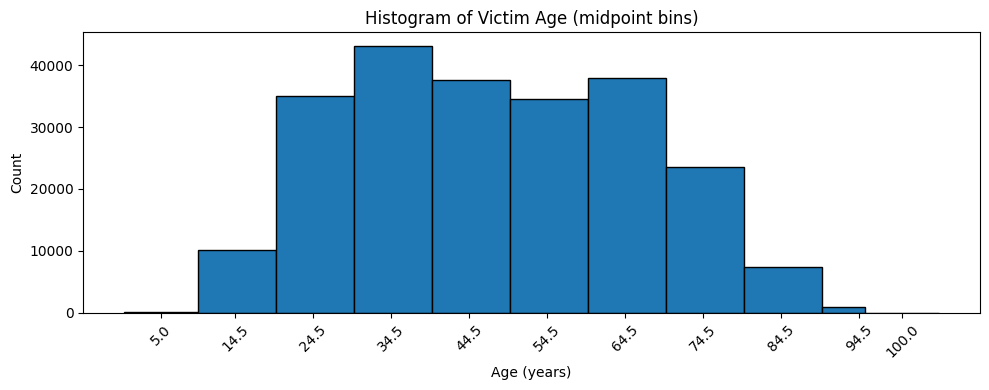

Complaint Received Type,CAFC Website,Email,In Person,Intercepted,Mail,Message,NCFRS,Other,Phone,Unknown
age_mid,,,,,,,,,,
5.0,129,1,0,0,0,0,0,0,31,0
14.5,4124,204,0,0,1,0,445,6,5291,0
24.5,17601,1024,2,0,0,0,2520,76,13717,1
34.5,22667,829,2,0,1,2,2554,71,16994,4
44.5,19000,806,0,0,1,2,1895,78,15818,4
54.5,15687,842,4,0,5,0,1617,68,16300,2
64.5,14486,1126,1,0,2,0,1503,36,20773,4
74.5,7157,1235,3,0,2,0,846,6,14242,0
84.5,1520,862,1,0,1,0,214,1,4854,1


In [ ]:
############################################################
# Quick visual & tabular check of Victim Age & Complaint Type
############################################################

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd


# 1️⃣ Missing rate of age_mid
miss_pct = df['age_mid'].isna().mean() * 100
print(f"Missing age_mid: {miss_pct:.1f}% of rows\n")

# 2️⃣ Histogram of age_mid with one bin per midpoint
midpoints = sorted(df['age_mid'].dropna().unique())
# assume equal spacing → half the distance between first two midpoints
half_bin = (midpoints[1] - midpoints[0]) / 2
# build edges so each midpoint is centered in its bin
bin_edges = [mp - half_bin for mp in midpoints] + [midpoints[-1] + half_bin]

plt.figure(figsize=(10, 4))
plt.hist(df['age_mid'].dropna(), bins=bin_edges, edgecolor='black')
plt.xticks(midpoints, rotation=45)
plt.title("Histogram of Victim Age (midpoint bins)")
plt.xlabel("Age (years)")
plt.ylabel("Count")
plt.tight_layout()
plt.show()

# 3️⃣ Crosstab: Age midpoint vs Complaint Type
age_complaint = pd.crosstab(
    df['age_mid'],
    df['Complaint Received Type'],   # or 'Complaint Type' if that's the column
    dropna=False
)
display(age_complaint)


In [ ]:
print(f"Shape now after cleaning: {df.shape}")
print("Remaining cols after cleaning:", df.columns.tolist())


Shape now after cleaning: (328649, 17)
Remaining cols after cleaning: ["Numéro d'identification / Number ID", 'Complaint Received Type', 'Country', 'Province/State', 'Fraud and Cybercrime Thematic Categories', 'Solicitation Method', 'Gender', 'Language of Correspondence', "Victim Age Range / Tranche d'âge des victimes", 'Complaint Type', 'Number of Victims / Nombre de victimes', 'Dollar Loss', 'Date Received', 'age_mid', 'age_low', 'age_high', 'age_non_person']


In [ ]:
############################################################
# === Assess MCAR Missingness to determine imputation strategy for age_mid ===
############################################################


import pandas as pd
import numpy as np
from scipy.stats import ks_2samp, chi2_contingency

# Boolean mask for missing age_mid
mask = df['age_mid'].isna()
n_missing = mask.sum()
n_total   = len(df)
print(f"{n_missing} of {n_total} rows have missing age_mid ({n_missing/n_total:.1%})\n")

# 1️⃣ Compare numeric features: KS‐test between age‐known vs age‐missing
numeric_feats = ['Dollar Loss', 'Number of Victims / Nombre de victimes']
for col in numeric_feats:
    present = df.loc[~mask, col].dropna()
    missing = df.loc[ mask, col].dropna()
    ks_stat, ks_p = ks_2samp(present, missing)
    print(f"Numeric: {col}")
    print("  mean (present):", present.mean(),
          "mean (missing):", missing.mean())
    print(f"  KS‐test p-value: {ks_p:.3f}")
    print()

# 2️⃣ Compare categorical features: Chi-square test
cat_feats = [
    'Complaint Received Type',
    'Province/State',
    'Fraud and Cybercrime Thematic Categories',
    'Solicitation Method'
]
for col in cat_feats:
    # build contingency table of value vs missingness
    ct = pd.crosstab(df[col].fillna('<<MISSING_CAT>>'), mask)
    chi2, p, dof, expected = chi2_contingency(ct)
    print(f"Categorical: {col}")
    print(f"  χ² p-value: {p:.3f}")
    print()

# 3️⃣ Summary: if p-values are large (>0.05), missingness ~ MCAR for that feature.



98308 of 328649 rows have missing age_mid (29.9%)

Numeric: Dollar Loss
  mean (present): 6224.089057180441 mean (missing): 8807.547126683485
  KS‐test p-value: 0.000

Numeric: Number of Victims / Nombre de victimes
  mean (present): 0.698768347797396 mean (missing): 0.5292448223949221
  KS‐test p-value: 0.000

Categorical: Complaint Received Type
  χ² p-value: 0.000

Categorical: Province/State
  χ² p-value: 0.000

Categorical: Fraud and Cybercrime Thematic Categories
  χ² p-value: 0.000

Categorical: Solicitation Method
  χ² p-value: 0.000



Total imputed ages: 98308
age_imputed dtype: float64


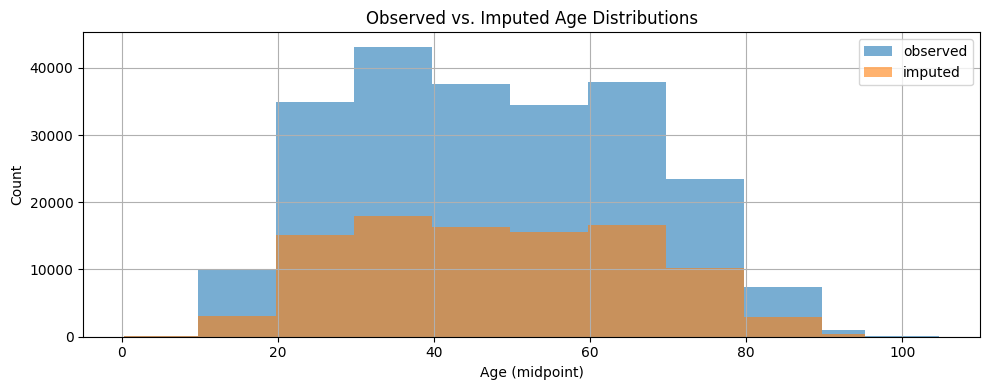

In [ ]:
############################################################
# === Stratified imputation strategy for age_mid missing values ===
#   • Primary stratification: Fraud & Cybercrime Thematic Categories
#   • Fallback: global distribution if a group is too small
############################################################
import numpy as np

# 1. Prepare columns
df['age_imputed']      = df['age_mid'].copy()
df['age_imputed_flag'] = df['age_mid'].isna()

# 2. Decide stratification column and minimum group size
primary_col = 'Fraud and Cybercrime Thematic Categories'
min_observed = 100

# 3. Precompute observed pools per group
observed_pools = {
    grp: grp_df['age_mid'].values
    for grp, grp_df in df[df['age_mid'].notna()]
                    .groupby(primary_col)
}

# 4. Impute by thematic category when possible
for grp, idxs in df[df['age_imputed_flag']].groupby(primary_col).groups.items():
    pool = observed_pools.get(grp, np.array([]))
    if len(pool) < min_observed:
        # fallback to global distribution
        pool = df['age_mid'].dropna().values
    df.loc[idxs, 'age_imputed'] = np.random.choice(pool, size=len(idxs), replace=True)

# 5. Quick check
print("Total imputed ages:", df['age_imputed_flag'].sum())
print("age_imputed dtype:", df['age_imputed'].dtype)

# 6. (Optional) Compare distributions before/after
import matplotlib.pyplot as plt
plt.figure(figsize=(10,4))
df['age_mid'].dropna().hist(bins=bin_edges, alpha=0.6, label='observed')
df.loc[df['age_imputed_flag'],'age_imputed']\
    .hist(bins=bin_edges, alpha=0.6, label='imputed')
plt.legend()
plt.title("Observed vs. Imputed Age Distributions")
plt.xlabel("Age (midpoint)")
plt.ylabel("Count")
plt.tight_layout()
plt.show()


In [ ]:
############################################################
# === Stratified imputation check  ===
############################################################
# How many were flagged (and thus imputed)?
print("Imputed count:", df['age_imputed_flag'].sum())

# Peek at a few imputed cases
df.loc[df['age_imputed_flag'],
       ['Victim Age Range / Tranche d\'âge des victimes', 'age_mid', 'age_imputed']
     ].sample(15)



Imputed count: 98308


,Victim Age Range / Tranche d'âge des victimes,age_mid,age_imputed
121396,Not Available / non disponible,NaN,74.5
232474,Not Available / non disponible,NaN,34.5
327269,Not Available / non disponible,NaN,44.5
273143,Not Available / non disponible,NaN,44.5
132164,Not Available / non disponible,NaN,34.5
157719,Not Available / non disponible,NaN,34.5
49485,Not Available / non disponible,NaN,64.5
293043,Not Available / non disponible,NaN,14.5
103584,Not Available / non disponible,NaN,34.5
130529,Not Available / non disponible,NaN,74.5


In [ ]:
############################################################
# CAFC – Quick-Look Data Exploration (Updated Overview)
############################################################

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# 1️⃣ Shape & samples
print("Dataset shape (rows, cols):", df.shape)
display(df.head())
display(df.sample(5, random_state=42))

# 2️⃣ Info & missingness
df.info(memory_usage="deep")
missing = df.isna().mean().sort_values(ascending=False) * 100
print("\nTop 20 columns by missing %:")
display(missing.head(20).to_frame("missing_pct"))

# 3️⃣ Numeric summary
num = df.select_dtypes(include=["number"])
print("\nNumeric features summary:")
display(num.describe().T)

# 4️⃣ Categorical summary (unique counts + top 10 values)
cat = df.select_dtypes(include=["object", "category"])
print("\nCategorical features overview:")
for col in cat.columns:
    vc = df[col].value_counts(dropna=False)
    print(f"\n• {col} (unique: {vc.size})")
    display(vc.head(10).to_frame("count"))

# 5️⃣ Cardinality (all columns)
card = df.nunique().sort_values(ascending=False)
print("\nColumns by cardinality (top 20):")
display(card.head(20).to_frame("unique_vals"))


Dataset shape (rows, cols): (328649, 19)


,Numéro d'identification / Number ID,Complaint Received Type,Country,Province/State,Fraud and Cybercrime Thematic Categories,Solicitation Method,Gender,Language of Correspondence,Victim Age Range / Tranche d'âge des victimes,Complaint Type,Number of Victims / Nombre de victimes,Dollar Loss,Date Received,age_mid,age_low,age_high,age_non_person,age_imputed,age_imputed_flag
0,1,CAFC Website,Canada,Saskatchewan,Merchandise,Other/unknown,Not Available,Not Available,Not Available / non disponible,Attempt,0,0.00,2021-01-02,NaN,NaN,NaN,False,54.5,True
1,2,CAFC Website,Not Specified,Not Specified,Merchandise,Internet,Not Available,Not Available,Not Available / non disponible,Victim,1,1000.00,2021-01-02,NaN,NaN,NaN,False,34.5,True
2,3,CAFC Website,Canada,Quebec,Identity Fraud,Other/unknown,Male,French,40 - 49,Victim,1,0.00,2021-01-02,44.5,40.0,49.0,False,44.5,False
3,4,CAFC Website,Canada,Saskatchewan,Phishing,Email,Male,English,30 - 39,Victim,1,0.00,2021-01-02,34.5,30.0,39.0,False,34.5,False
4,5,CAFC Website,Canada,Saskatchewan,Merchandise,Other/unknown,Male,Not Available,60 - 69,Victim,1,222.73,2021-01-02,64.5,60.0,69.0,False,64.5,False


,Numéro d'identification / Number ID,Complaint Received Type,Country,Province/State,Fraud and Cybercrime Thematic Categories,Solicitation Method,Gender,Language of Correspondence,Victim Age Range / Tranche d'âge des victimes,Complaint Type,Number of Victims / Nombre de victimes,Dollar Loss,Date Received,age_mid,age_low,age_high,age_non_person,age_imputed,age_imputed_flag
103452,103453,CAFC Website,Not Specified,Not Specified,Job,Internet-social network,Not Available,Not Available,Not Available / non disponible,Victim,1,6340.0,2021-12-10,NaN,NaN,NaN,False,24.5,True
104548,104549,Phone,Canada,Quebec,Service,Text message,Female,English,20 - 29,Victim,1,900.0,2021-12-15,24.5,20.0,29.0,False,24.5,False
207633,207634,CAFC Website,Canada,British Columbia,Recovery Pitch,Direct call,Female,English,40 - 49,Victim,1,45000.0,2023-01-29,44.5,40.0,49.0,False,44.5,False
315412,315413,CAFC Website,Canada,Manitoba,Merchandise,Internet-social network,Female,English,30 - 39,Victim,1,250.0,2024-12-23,34.5,30.0,39.0,False,34.5,False
258413,258414,Phone,Canada,Ontario,Identity Fraud,Other/unknown,Female,English,50 - 59,Victim,1,0.0,2023-11-17,54.5,50.0,59.0,False,54.5,False


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 328649 entries, 0 to 328648
Data columns (total 19 columns):
 #   Column                                         Non-Null Count   Dtype         
---  ------                                         --------------   -----         
 0   Numéro d'identification / Number ID            328649 non-null  int64         
 1   Complaint Received Type                        328649 non-null  object        
 2   Country                                        328649 non-null  object        
 3   Province/State                                 328649 non-null  object        
 4   Fraud and Cybercrime Thematic Categories       328649 non-null  object        
 5   Solicitation Method                            328649 non-null  object        
 6   Gender                                         328649 non-null  object        
 7   Language of Correspondence                     328649 non-null  object        
 8   Victim Age Range / Tranche d'âge des victime

,missing_pct
age_low,29.912764
age_high,29.912764
age_mid,29.912764
Country,0.000000
Complaint Received Type,0.000000
Numéro d'identification / Number ID,0.000000
Province/State,0.000000
Language of Correspondence,0.000000
Fraud and Cybercrime Thematic Categories,0.000000
Solicitation Method,0.000000



Numeric features summary:


,count,mean,std,min,25%,50%,75%,max
Numéro d'identification / Number ID,328649.0,164325.000000,94872.938647,1.0,82163.0,164325.0,246487.0,328649.0
Number of Victims / Nombre de victimes,328649.0,0.648059,0.477576,0.0,0.0,1.0,1.0,1.0
Dollar Loss,328649.0,6996.872774,102328.000476,0.0,0.0,0.0,0.0,23615000.0
age_mid,230341.0,47.627930,18.598523,5.0,34.5,44.5,64.5,100.0
age_low,230341.0,43.129452,18.601169,1.0,30.0,40.0,60.0,100.0
age_high,230341.0,52.126408,18.596170,9.0,39.0,49.0,69.0,100.0
age_imputed,328649.0,47.773832,18.481855,5.0,34.5,44.5,64.5,100.0



Categorical features overview:

• Complaint Received Type (unique: 10)


,count
Complaint Received Type,
CAFC Website,174178
Phone,116794
Email,21633
NCFRS,15537
Other,424
Mail,45
Unknown,17
In Person,16
Message,4



• Country (unique: 159)


,count
Country,
Canada,249795
Not Specified,74367
United States,2074
India,245
United Kingdom,157
France,142
Australia,116
Pakistan,84
United Arab Emirates,80



• Province/State (unique: 67)


,count
Province/State,
Ontario,96150
Not Specified,77767
Quebec,67041
British Columbia,31604
Alberta,26189
Manitoba,9014
Saskatchewan,5889
Nova Scotia,5334
New Brunswick,4408



• Fraud and Cybercrime Thematic Categories (unique: 39)


,count
Fraud and Cybercrime Thematic Categories,
Identity Fraud,75475
Extortion,31444
Phishing,28433
Personal Info,26847
Service,25225
Investments,18124
Merchandise,17242
Bank Investigator,14029
Counterfeit Merchandise,13254



• Solicitation Method (unique: 14)


,count
Solicitation Method,
Other/unknown,95692
Direct call,77299
Email,37102
Internet-social network,36537
Internet,31204
Text message,26140
Not Available,17387
Door to door/in person,3916
Mail,2951



• Gender (unique: 6)


,count
Gender,
Female,123639
Male,119076
Not Available,84113
Unknown,1065
Prefer not to say,485
Other,271



• Language of Correspondence (unique: 3)


,count
Language of Correspondence,
English,182023
Not Available,84555
French,62071



• Victim Age Range / Tranche d'âge des victimes (unique: 14)


,count
Victim Age Range / Tranche d'âge des victimes,
Not Available / non disponible,98111
30 - 39,43124
60 - 69,37931
40 - 49,37604
20 - 29,34941
50 - 59,34525
70 - 79,23491
10 - 19,10071
80 - 89,7454



• Complaint Type (unique: 5)


,count
Complaint Type,
Victim,212984
Attempt,108038
Other,6128
Unknown,1026
Incomplete,473



Columns by cardinality (top 20):


,unique_vals
Numéro d'identification / Number ID,328649
Dollar Loss,24630
Date Received,1545
Country,159
Province/State,67
Fraud and Cybercrime Thematic Categories,39
Solicitation Method,14
Victim Age Range / Tranche d'âge des victimes,14
age_high,11
age_low,11


# EDA

# Univariate Analysis

In [ ]:
############################################################
# Number of Victims (repeated for all other features quickly) – Plotly Express
############################################################
import plotly.express as px

# Print unique values count
unique_count = df["Number of Victims / Nombre de victimes"].nunique()
print(f"Unique Number of Victims values: {unique_count}")

# 1️⃣ Count bar chart
fig_nv_bar = px.histogram(
    df,
    x="Number of Victims / Nombre de victimes",
    title="Number of Victims – Count",
    labels={
        "Number of Victims / Nombre de victimes": "Number of Victims",
        "count": "Number of Reports"
    },
    color="Number of Victims / Nombre de victimes",
    height=450
)
fig_nv_bar.update_layout(
    showlegend=False,
    xaxis_tickangle=-45,
    margin=dict(l=40, r=20, t=50, b=100)
)
fig_nv_bar.show()

# 2️⃣ Donut chart of share
fig_nv_pie = px.pie(
    df,
    names="Number of Victims / Nombre de victimes",
    title="Number of Victims – Share",
    hole=0.4,
    height=450
)
fig_nv_pie.update_traces(textposition='inside', textinfo='percent+label')
fig_nv_pie.show()


Unique Number of Victims values: 2


In [ ]:
############################################################
# Dollar Loss – Bucketed & Log‐Scale Distributions (Plotly)
############################################################

import numpy as np
import pandas as pd
import plotly.express as px

# 1️⃣ Filter to reported losses (skip NaN)
df_loss = df[df['Dollar Loss'].notna()]

# 2️⃣ Define reasonable buckets
max_loss = df_loss['Dollar Loss'].max()
bins = [0, 1, 100, 500, 1_000, 5_000, 10_000, 50_000, 100_000, 500_000, 1_000_000, max_loss]
labels = [
    '0',
    '1–99',
    '100–499',
    '500–999',
    '1K–4.9K',
    '5K–9.9K',
    '10K–49.9K',
    '50K–99.9K',
    '100K–499.9K',
    '500K–999.9K',
    '1M+'
]
df_loss['loss_bucket'] = pd.cut(
    df_loss['Dollar Loss'],
    bins=bins,
    labels=labels,
    include_lowest=True,
    right=False
)

# 3️⃣ Bar chart of buckets
fig_bucket = px.histogram(
    df_loss,
    x='loss_bucket',
    category_orders={'loss_bucket': labels},
    title='Reported Dollar Loss by Bucket',
    labels={'loss_bucket': 'Dollar Loss Range', 'count': 'Number of Reports'},
    color='loss_bucket',
    height=450
)
fig_bucket.update_layout(
    showlegend=False,
    xaxis_tickangle=-45,
    margin=dict(l=40, r=20, t=50, b=120)
)
fig_bucket.show()

# 4️⃣ Histogram on log‐scaled y‐axis
fig_log = px.histogram(
    df_loss,
    x='Dollar Loss',
    nbins=50,
    log_y=True,
    title='Distribution of Reported Dollar Loss (Log Scale Y)',
    labels={'Dollar Loss': 'Dollar Loss ($)', 'count': 'Count'},
    height=450
)
fig_log.show()


# Asking specific research questions

In [ ]:
############################################################
# Top 10 Fraud Themes by Loss – Corrected Markdown + Plotly
############################################################
import pandas as pd
import plotly.express as px

# 1️⃣ Aggregate losses by fraud theme
loss_df = (
    df
      .groupby("Fraud and Cybercrime Thematic Categories")["Dollar Loss"]
      .agg(total_loss="sum", average_loss="mean")
      .reset_index()
)

# 2️⃣ Add formatted columns for Markdown & Plot labels
loss_df["total_loss_fmt"]   = loss_df["total_loss"].map("{:,.2f}".format)
loss_df["average_loss_fmt"] = loss_df["average_loss"].map("{:,.2f}".format)

# 3️⃣ Prepare top‐10 DataFrames
top_total = loss_df.nlargest(10, "total_loss")
top_avg   = loss_df.nlargest(10, "average_loss")

# 4️⃣ Markdown tables (copy-paste into Obsidian)
print("### Top 10 Fraud Themes by TOTAL Loss\n")
print(
    top_total[["Fraud and Cybercrime Thematic Categories", "total_loss_fmt"]]
      .rename(columns={
          "Fraud and Cybercrime Thematic Categories": "Fraud Theme",
          "total_loss_fmt": "Total Loss (CAD)"
      })
      .to_markdown(index=False)
)

print("\n### Top 10 Fraud Themes by AVERAGE Loss\n")
print(
    top_avg[["Fraud and Cybercrime Thematic Categories", "average_loss_fmt"]]
      .rename(columns={
          "Fraud and Cybercrime Thematic Categories": "Fraud Theme",
          "average_loss_fmt": "Average Loss (CAD)"
      })
      .to_markdown(index=False)
)

# 5️⃣ Bar chart: total loss
fig1 = px.bar(
    top_total,
    x="Fraud and Cybercrime Thematic Categories",
    y="total_loss",
    text="total_loss_fmt",
    title="Top 10 Fraud Themes by Total Dollar Loss",
    labels={"total_loss": "Total Loss (CAD)", "Fraud and Cybercrime Thematic Categories": "Fraud Theme"},
    height=450
)
fig1.update_layout(xaxis_tickangle=-45, showlegend=False)
fig1.show()

# 6️⃣ Bar chart: average loss
fig2 = px.bar(
    top_avg,
    x="Fraud and Cybercrime Thematic Categories",
    y="average_loss",
    text="average_loss_fmt",
    title="Top 10 Fraud Themes by Average Dollar Loss",
    labels={"average_loss": "Average Loss (CAD)", "Fraud and Cybercrime Thematic Categories": "Fraud Theme"},
    height=450
)
fig2.update_layout(xaxis_tickangle=-45, showlegend=False)
fig2.show()


### Top 10 Fraud Themes by TOTAL Loss

| Fraud Theme       | Total Loss (CAD)   |
|:------------------|:-------------------|
| Investments       | 1,184,422,761.23   |
| Romance           | 255,597,741.36     |
| Spear Phishing    | 246,288,673.31     |
| Job               | 119,282,927.19     |
| Service           | 80,662,586.69      |
| Extortion         | 74,161,485.99      |
| Unknown           | 56,247,004.75      |
| Bank Investigator | 45,606,678.45      |
| Merchandise       | 44,067,543.44      |
| Other             | 41,676,461.88      |

### Top 10 Fraud Themes by AVERAGE Loss

| Fraud Theme         | Average Loss (CAD)   |
|:--------------------|:---------------------|
| Investments         | 65,351.07            |
| Spear Phishing      | 41,680.26            |
| Timeshare           | 41,542.15            |
| Romance             | 41,218.79            |
| Recovery Pitch      | 16,482.91            |
| Foreign Money Offer | 11,836.45            |
| Loan                | 9,2

In [ ]:
############################################################
# Report Counts by Age Group & Gender
############################################################

import plotly.express as px

age_col = "Victim Age Range / Tranche d'âge des victimes"

# Figure 1: Report Counts by Age Group & Gender (Known Ages Only)
df_known = df[df['age_mid'].notna()]

# Determine bucket order by midpoint
bucket_order = (
    df_known.groupby(age_col)['age_mid']
            .first()
            .sort_values()
            .index
            .tolist()
)

# Aggregate counts
agg = (
    df_known
      .groupby([age_col, "Gender"])
      .size()
      .reset_index(name="count")
)

# Plot without error bars
fig1 = px.bar(
    agg,
    x=age_col,
    y="count",
    color="Gender",
    barmode="group",
    category_orders={age_col: bucket_order},
    title="Report Counts by Age Group & Gender (Known Ages Only)",
    labels={age_col: "Age Group", "count": "Number of Reports"},
    height=500
)
fig1.update_layout(
    xaxis_tickangle=-45,
    margin=dict(l=40, r=20, t=50, b=120)
)
fig1.show()


# Figure 2: Fraud Themes by Gender (ignoring Age) – unchanged
desired_genders = ["Male", "Female", "Not Available / non disponible"]
df_f3 = df[df["Gender"].isin(desired_genders)]

fig2 = px.histogram(
    df_f3,
    x="Fraud and Cybercrime Thematic Categories",
    color="Gender",
    barmode="group",
    category_orders={
        "Gender": desired_genders,
        "Fraud and Cybercrime Thematic Categories": df_f3["Fraud and Cybercrime Thematic Categories"]
                                                               .value_counts()
                                                               .index
                                                               .tolist()
    },
    title="Fraud Themes by Gender (ignoring Age)",
    labels={
        "Fraud and Cybercrime Thematic Categories": "Fraud Theme",
        "count": "Number of Reports"
    },
    height=500
)
fig2.update_layout(xaxis_tickangle=-45, margin=dict(l=40, r=20, t=50, b=120))
fig2.show()


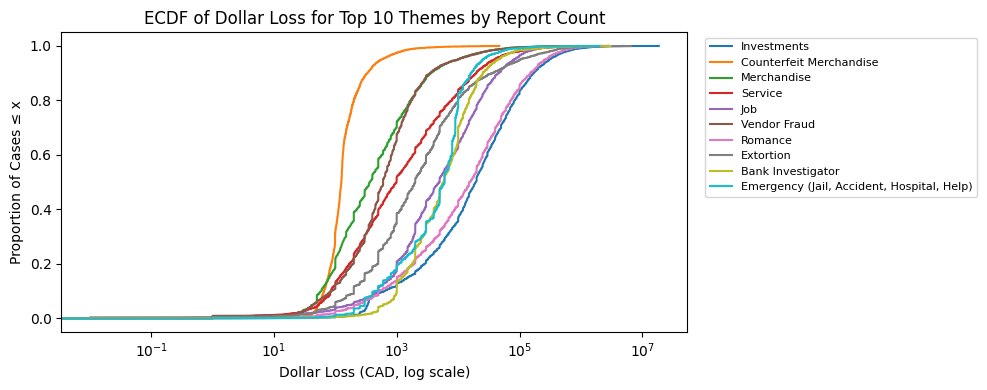

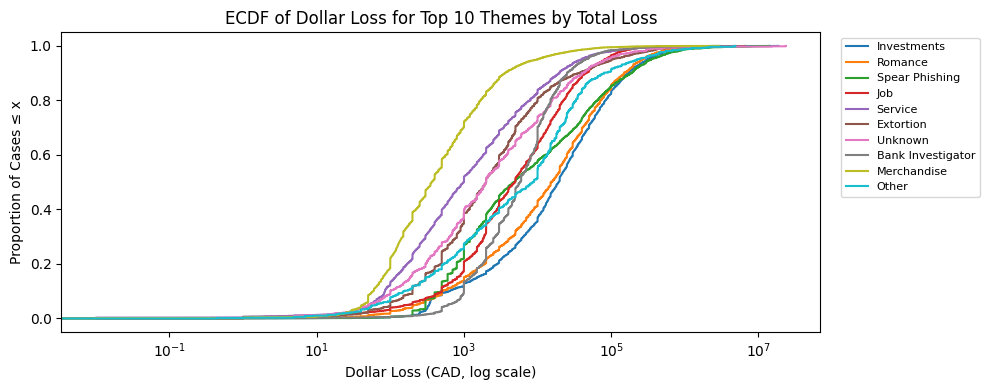

In [ ]:
############################################################
# ECDF Plots: Report Counts & Total Dollar Loss per Theme
############################################################

import matplotlib.pyplot as plt
from statsmodels.distributions.empirical_distribution import ECDF

# Filter to positive losses only
df_pos = df[df['Dollar Loss'] > 0]

# 1️⃣ ECDF for top 10 themes by REPORT COUNT
top10_count = (
    df_pos
      .groupby('Fraud and Cybercrime Thematic Categories')
      .size()
      .nlargest(10)
      .index
      .tolist()
)
plt.figure(figsize=(10, 4))
for theme in top10_count:
    vals = df_pos.loc[df_pos['Fraud and Cybercrime Thematic Categories'] == theme, 'Dollar Loss']
    ecdf = ECDF(vals)
    plt.step(ecdf.x, ecdf.y, where='post', label=theme)
plt.xscale('log')
plt.title("ECDF of Dollar Loss for Top 10 Themes by Report Count")
plt.xlabel("Dollar Loss (CAD, log scale)")
plt.ylabel("Proportion of Cases ≤ x")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=8)
plt.tight_layout()
plt.show()

# 2️⃣ ECDF for top 10 themes by TOTAL LOSS
top10_loss = (
    df_pos
      .groupby('Fraud and Cybercrime Thematic Categories')['Dollar Loss']
      .sum()
      .nlargest(10)
      .index
      .tolist()
)
plt.figure(figsize=(10, 4))
for theme in top10_loss:
    vals = df_pos.loc[df_pos['Fraud and Cybercrime Thematic Categories'] == theme, 'Dollar Loss']
    ecdf = ECDF(vals)
    plt.step(ecdf.x, ecdf.y, where='post', label=theme)
plt.xscale('log')
plt.title("ECDF of Dollar Loss for Top 10 Themes by Total Loss")
plt.xlabel("Dollar Loss (CAD, log scale)")
plt.ylabel("Proportion of Cases ≤ x")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', fontsize=8)
plt.tight_layout()
plt.show()






In [ ]:
#####################################################################
# Stevie Questions on Romance and Gender
#####################################################################
import pandas as pd
import plotly.express as px
from statsmodels.distributions.empirical_distribution import ECDF

# -------------------------------------------------------------------
# CONFIG: keep only these gender & complaint labels
keep_genders  = ["Male", "Female"]
keep_ctypes   = ["Victim", "Attempt"]
age_bucket_col = "Victim Age Range / Tranche d'âge des victimes"
# -------------------------------------------------------------------

#####################################################################
# 1️⃣ Romance fraud – peak age & total loss, Male vs Female only
#####################################################################
rom_df = (
    df[
        (df["Fraud and Cybercrime Thematic Categories"] == "Romance") &
        (df["Gender"].isin(keep_genders)) &
        (df[age_bucket_col].notna())
    ].copy()
)

# A) Peak age bucket per gender
peak_age = (
    rom_df
      .groupby(["Gender", age_bucket_col])
      .size()
      .reset_index(name="reports")
      .sort_values(["Gender", "reports"], ascending=[True, False])
      .groupby("Gender")
      .first()
      .reset_index()
      .rename(columns={age_bucket_col: "peak_age_bucket"})
)

# B) Total loss per gender
total_loss = (
    rom_df
      .groupby("Gender")["Dollar Loss"]
      .sum()
      .rename("total_loss")
      .reset_index()
)

# C) Merge & print Markdown
rom_summary = pd.merge(peak_age, total_loss, on="Gender")
rom_summary["total_loss"] = rom_summary["total_loss"].map("{:,.2f}".format)

print("### Romance Fraud – Peak Age Bucket & Total Loss by Gender\n")
print(rom_summary.to_markdown(index=False))

# D) Bar chart: Romance report counts by age & gender
fig_rom = px.bar(
    rom_df.groupby(["Gender", age_bucket_col]).size().reset_index(name="reports"),
    x=age_bucket_col,
    y="reports",
    color="Gender",
    barmode="group",
    category_orders={age_bucket_col: sorted(rom_df[age_bucket_col].unique())},
    title="Romance Fraud Reports by Age Bucket & Gender",
    labels={"reports": "Number of Reports", age_bucket_col: "Age Bucket"},
    height=450
)
fig_rom.update_layout(xaxis_tickangle=-45, margin=dict(t=60, b=120))
fig_rom.show()

#####################################################################
# 2️⃣ Complaint Type vs Gender & Fraud Theme (Filtered)
#####################################################################
df_ct = df[
    df["Gender"].isin(keep_genders) &
    df["Complaint Type"].isin(keep_ctypes)
]

# A) Quick Markdown table of Complaint Type × Gender counts
pivot_ct_gender = (
    df_ct.groupby(["Complaint Type", "Gender"])
         .size()
         .unstack(fill_value=0)
         .loc[keep_ctypes, keep_genders]   # ensure order
)

print("\n### Complaint Type × Gender (Filtered to Victim / Attempt & Male / Female)\n")
print(pivot_ct_gender.to_markdown())

# B) Plot: Complaint Type counts faceted by Gender, coloured by Fraud Theme
#################################################################
# B) Plot: Complaint Type counts faceted by Gender, top-10 themes each
#################################################################

# --- Identify top 10 fraud themes separately for Male and Female
top_themes = {}
for g in keep_genders:
    top_themes[g] = (
        df_ct[df_ct["Gender"] == g]
          .groupby("Fraud and Cybercrime Thematic Categories")
          .size()
          .nlargest(10)
          .index
          .tolist()
    )

# --- Keep only rows whose theme is in that gender’s top-10 list
mask = df_ct.apply(
    lambda row: row["Fraud and Cybercrime Thematic Categories"] in top_themes[row["Gender"]],
    axis=1
)
df_ct_top = df_ct[mask].copy()

# --- Ensure category order for nice, repeatable colours
ordered_themes = sorted(set(top_themes["Male"] + top_themes["Female"]))

fig_ct = px.histogram(
    df_ct_top,
    x="Complaint Type",
    color="Fraud and Cybercrime Thematic Categories",
    facet_col="Gender",
    category_orders={
        "Complaint Type": keep_ctypes,
        "Gender": keep_genders,
        "Fraud and Cybercrime Thematic Categories": ordered_themes
    },
    barmode="group",
    title="Complaint Type by Gender – Top 10 Fraud Themes per Gender",
    labels={"count": "Number of Reports"},
    height=600
)
fig_ct.update_layout(margin=dict(t=60, b=120))
fig_ct.show()


### Romance Fraud – Peak Age Bucket & Total Loss by Gender

| Gender   | peak_age_bucket   |   reports | total_loss     |
|:---------|:------------------|----------:|:---------------|
| Female   | 60 - 69           |       558 | 129,870,493.35 |
| Male     | 60 - 69           |       350 | 68,990,292.37  |



### Complaint Type × Gender (Filtered to Victim / Attempt & Male / Female)

| Complaint Type   |   Male |   Female |
|:-----------------|-------:|---------:|
| Victim           |  85143 |    85938 |
| Attempt          |  31869 |    35518 |


In [ ]:
############################################################
# Solicitation Method — Report Count, Total Loss, Average Loss
############################################################
import pandas as pd
import numpy as np
import plotly.express as px

# --- 1️⃣ Aggregate metrics ----------------------------------------------------
#   • reports  = total number of records (attempt + victim)
#   • total_loss = sum of Dollar Loss (zeros included)
#   • avg_loss_pos = mean Dollar Loss *among positive losses only*
metrics = (
    df.groupby("Solicitation Method")["Dollar Loss"]
      .agg(
          reports       ="count",
          total_loss    ="sum",
          avg_loss_pos  =lambda s: s[s>0].mean()   # avoid inflating mean with zeros
      )
      .reset_index()
)

# Keep a formatted copy for easy Markdown paste
tbl = metrics.copy()
tbl["total_loss"]   = tbl["total_loss"].map("{:,.2f}".format)
tbl["avg_loss_pos"] = tbl["avg_loss_pos"].map("{:,.2f}".format)

print("### Solicitation Method – Reports, Total Loss, Avg Loss (positive only)\n")
print(tbl.to_markdown(index=False))

# --- 2️⃣ Bar chart: Report count ---------------------------------------------
fig_cnt = px.bar(
    metrics.sort_values("reports", ascending=False),
    x="Solicitation Method",
    y="reports",
    title="Number of Reports by Solicitation Method",
    labels={"reports":"Number of Reports"},
    text="reports",
    height=450
)
fig_cnt.update_layout(xaxis_tickangle=-45, showlegend=False, margin=dict(t=60, b=120))
fig_cnt.show()

# --- 3️⃣ Bar chart: Total loss -----------------------------------------------
fig_tot = px.bar(
    metrics.sort_values("total_loss", ascending=False),
    x="Solicitation Method",
    y="total_loss",
    title="Total Dollar Loss by Solicitation Method",
    labels={"total_loss":"Total Loss (CAD)"},
    text=metrics.sort_values("total_loss", ascending=False)["total_loss"].map("{:,.0f}".format),
    height=450
)
fig_tot.update_layout(xaxis_tickangle=-45, showlegend=False, margin=dict(t=60, b=120))
fig_tot.show()

# --- 4️⃣ Bar chart: Average loss (positive cases only) ------------------------
fig_avg = px.bar(
    metrics.sort_values("avg_loss_pos", ascending=False),
    x="Solicitation Method",
    y="avg_loss_pos",
    title="Average Dollar Loss (Positive Cases) by Solicitation Method",
    labels={"avg_loss_pos":"Average Loss (CAD)"},
    text=metrics.sort_values("avg_loss_pos", ascending=False)["avg_loss_pos"].map("{:,.0f}".format),
    height=450
)
fig_avg.update_layout(xaxis_tickangle=-45, showlegend=False, margin=dict(t=60, b=120))
fig_avg.show()


### Solicitation Method – Reports, Total Loss, Avg Loss (positive only)

| Solicitation Method     |   reports | total_loss     | avg_loss_pos   |
|:------------------------|----------:|:---------------|:---------------|
| Direct call             |     77299 | 252,135,791.54 | 24,313.96      |
| Door to door/in person  |      3916 | 59,805,950.29  | 51,335.58      |
| Email                   |     37102 | 304,831,567.39 | 47,078.23      |
| Fax                     |       167 | 16,039.98      | 5,346.66       |
| Internet                |     31204 | 595,958,584.70 | 31,172.64      |
| Internet-social network |     36537 | 717,042,504.87 | 29,289.76      |
| Mail                    |      2951 | 2,167,736.14   | 15,483.83      |
| Not Available           |     17387 | 54,081,627.27  | 4,706.84       |
| Other/unknown           |     95692 | 208,915,074.13 | 63,269.25      |
| Print                   |        57 | 690,794.48     | 36,357.60      |
| Radio                   |         7 |

In [ ]:
import pandas as pd
import plotly.express as px

##############################################################################
# CONFIG ─ define what counts as “unspecified” and how many provinces to keep
##############################################################################
unspecified = ["Not Available / non disponible", "Unknown", "Not Specified"]
TOP_N = 10
theme_col = "Fraud and Cybercrime Thematic Categories"
prov_col  = "Province/State"

##############################################################################
# 1️⃣ Top-10 provinces by report count  (exclude unspecified)
##############################################################################
df_cleanprov = df[~df[prov_col].isin(unspecified)]
prov_counts  = (
    df_cleanprov[prov_col]
      .value_counts()
      .head(TOP_N)
      .rename_axis("Province/State")      # ⇠ name the index
      .reset_index(name="reports")        # ⇠ now columns are ['Province/State','reports']
)
top_provs = prov_counts["Province/State"].tolist()

# Markdown
print("### Top 10 Provinces by Number of Reports\n")
print(prov_counts.to_markdown(index=False))

# Bar chart
fig1 = px.bar(
    prov_counts,
    x="Province/State",
    y="reports",
    title="Top 10 Provinces by Report Count",
    labels={"Province/State":"Province / State", "reports":"Number of Reports"},
    text="reports",
    height=450
)
fig1.update_layout(xaxis_tickangle=-45, showlegend=False, margin=dict(t=60, b=120))
fig1.show()


##############################################################################
# 2️⃣ Fraud-theme mix in Top-10 Provinces — by TOTAL LOSS (Top-10 themes)
##############################################################################
df_top = df_cleanprov[df_cleanprov[prov_col].isin(top_provs)]

# --- keep only rows with positive loss so sums make sense
df_top_pos = df_top[df_top["Dollar Loss"] > 0]

# --- identify 10 themes with largest total loss (within the 10 provinces)
top_themes_loss = (
    df_top_pos
      .groupby(theme_col)["Dollar Loss"]
      .sum()
      .nlargest(10)
      .index
      .tolist()
)

# --- aggregate total loss per (province, theme)
loss_mix = (
    df_top_pos[df_top_pos[theme_col].isin(top_themes_loss)]
      .groupby([prov_col, theme_col])["Dollar Loss"]
      .sum()
      .reset_index()
)

fig2_loss = px.bar(
    loss_mix,
    x=prov_col,
    y="Dollar Loss",
    color=theme_col,
    category_orders={
        prov_col: top_provs,            # preserve province order from step 1
        theme_col: top_themes_loss      # show only the 10 top-loss themes
    },
    title="Fraud-Theme Mix in Top 10 Provinces (by Total Dollar Loss)",
    labels={prov_col: "Province / State", "Dollar Loss": "Total Loss (CAD)"},
    height=500
)
fig2_loss.update_layout(xaxis_tickangle=-45)
fig2_loss.show()



##############################################################################
# 3️⃣ Total dollar loss in those provinces (positive losses only)
##############################################################################
loss_tbl = (
    df_top[df_top["Dollar Loss"] > 0]
      .groupby(prov_col)["Dollar Loss"]
      .sum()
      .sort_values(ascending=False)
)

# Markdown summary
print("\n### Total Dollar Loss (CAD) in Top 10 Provinces\n")
print(loss_tbl.map("{:,.2f}".format).to_frame("total_loss").to_markdown())

# Bar chart
fig3 = px.bar(
    loss_tbl.reset_index(),
    x=prov_col,
    y="Dollar Loss",
    title="Total Dollar Loss in Top 10 Provinces",
    labels={"Province/State":"Province / State", "Dollar Loss":"Total Loss (CAD)"},
    text=loss_tbl.reset_index()["Dollar Loss"].map("{:,.0f}".format)
)
fig3.update_layout(xaxis_tickangle=-45, showlegend=False, height=450)
fig3.show()


### Top 10 Provinces by Number of Reports

| Province/State            |   reports |
|:--------------------------|----------:|
| Ontario                   |     96150 |
| Quebec                    |     67041 |
| British Columbia          |     31604 |
| Alberta                   |     26189 |
| Manitoba                  |      9014 |
| Saskatchewan              |      5889 |
| Nova Scotia               |      5334 |
| New Brunswick             |      4408 |
| Newfoundland And Labrador |      1912 |
| Prince Edward Island      |       857 |



### Total Dollar Loss (CAD) in Top 10 Provinces

| Province/State            | total_loss     |
|:--------------------------|:---------------|
| Ontario                   | 870,710,149.23 |
| British Columbia          | 302,740,382.25 |
| Alberta                   | 218,334,432.59 |
| Quebec                    | 198,507,196.26 |
| Manitoba                  | 77,431,085.95  |
| Saskatchewan              | 43,153,564.20  |
| Nova Scotia               | 23,974,554.28  |
| New Brunswick             | 19,516,396.28  |
| Newfoundland And Labrador | 9,963,503.26   |
| Prince Edward Island      | 3,350,559.50   |


In [ ]:
###################################################################
# Are specific complaint types (Victim, Attempt) more frequent in some fraud types?
###################################################################

import pandas as pd
import scipy.stats as stats
import plotly.express as px

# -----------------------------------------------------------------
# CONFIG
ct_col    = "Complaint Type"                                  # Victim / Attempt
theme_col = "Fraud and Cybercrime Thematic Categories"
keep_ct   = ["Victim", "Attempt"]                             # focus on the two main types
# -----------------------------------------------------------------

###################################################################
# 1️⃣ Cross-tab of counts  (Fraud Theme × Complaint Type)
###################################################################
ctab = (
    df[df[ct_col].isin(keep_ct)]
      .groupby([theme_col, ct_col])
      .size()
      .unstack(fill_value=0)
)

# χ² test of independence across the full contingency table
chi2, p, dof, _ = stats.chi2_contingency(ctab.values)

print(f"Chi-square test across themes: χ²={chi2:.1f}, dof={dof}, p={p:.3e}")

# -----------------------------------------------------------------
# Quick Markdown table of counts + Victim %
summary = ctab.copy()
summary["Victim %"] = summary["Victim"] / summary.sum(axis=1)
print("\n### Victim vs Attempt Counts by Fraud Theme\n")
print(summary.to_markdown())

###################################################################
# 2️⃣ Visual: stacked bar of counts
###################################################################
long = (
    ctab.reset_index()
        .melt(id_vars=theme_col, value_vars=keep_ct, var_name="Complaint", value_name="reports")
)

fig = px.bar(
    long,
    x=theme_col,
    y="reports",
    color="Complaint",
    barmode="stack",
    title="Complaint Type Distribution Across Fraud Themes",
    labels={"reports":"Number of Reports", theme_col:"Fraud Theme"},
    height=550
)
fig.update_layout(xaxis_tickangle=-45)
fig.show()

###################################################################
# 3️⃣ Top themes skewed to Victim or Attempt
###################################################################
victim_heavy   = summary.sort_values("Victim %", ascending=False).head(5)
attempt_heavy  = summary.sort_values("Victim %").head(5)

print("\n### Top 5 Themes Skewed to Victim\n")
print(victim_heavy[["Victim", "Attempt", "Victim %"]].to_markdown())

print("\n### Top 5 Themes Skewed to Attempt\n")
print(attempt_heavy[["Victim", "Attempt", "Victim %"]].to_markdown())


Chi-square test across themes: χ²=122058.7, dof=38, p=0.000e+00

### Victim vs Attempt Counts by Fraud Theme

| Fraud and Cybercrime Thematic Categories   |   Attempt |   Victim |   Victim % |
|:-------------------------------------------|----------:|---------:|-----------:|
| Bank Investigator                          |      8835 |     5120 |   0.366894 |
| Charity / Donation                         |       259 |      160 |   0.381862 |
| Collection Agency                          |      1180 |      209 |   0.150468 |
| Counterfeit Merchandise                    |       157 |    13066 |   0.988127 |
| Credit Card                                |         4 |       54 |   0.931034 |
| Directory                                  |        38 |       11 |   0.22449  |
| Emergency (Jail, Accident, Hospital, Help) |      4419 |     3227 |   0.422051 |
| Extortion                                  |     23181 |     7966 |   0.255755 |
| False Billing                              |      1313 |  


### Top 5 Themes Skewed to Victim

| Fraud and Cybercrime Thematic Categories   |   Victim |   Attempt |   Victim % |
|:-------------------------------------------|---------:|----------:|-----------:|
| Modem-Hijacking                            |        1 |         0 |   1        |
| Identity Fraud                             |    74633 |       732 |   0.990287 |
| Counterfeit Merchandise                    |    13066 |       157 |   0.988127 |
| Credit Card                                |       54 |         4 |   0.931034 |
| Investments                                |    16672 |      1283 |   0.928544 |

### Top 5 Themes Skewed to Attempt

| Fraud and Cybercrime Thematic Categories   |   Victim |   Attempt |   Victim % |
|:-------------------------------------------|---------:|----------:|-----------:|
| Office Supplies                            |        1 |         7 |   0.125    |
| Collection Agency                          |      209 |      1180 |   0.150468 |
| Survey      

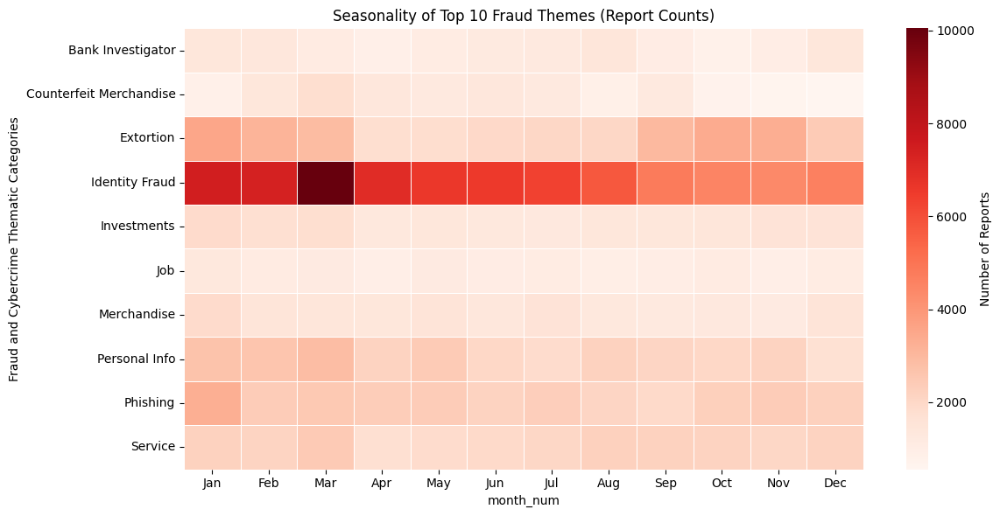

In [ ]:
##############################################################################
# 0️⃣  Prep: ensure Date Received is datetime & add helpers
##############################################################################

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

##############################################################################
# 0️⃣  Prep: ensure Date Received is datetime & add helpers
##############################################################################
df['Date Received'] = pd.to_datetime(df['Date Received'])
df['year_month']    = df['Date Received'].dt.to_period('M')
df['year_quarter']  = df['Date Received'].dt.to_period('Q')
df['month_name']    = df['Date Received'].dt.strftime('%b')
df['month_num']     = df['Date Received'].dt.month        # for ordering

##############################################################################
# 1️⃣ MonthlyTrend ─ total reports per month + 12-month rolling average
##############################################################################
monthly = (
    df.groupby('year_month')
      .size()
      .rename('reports')
      .to_timestamp()
)

rolling12 = monthly.rolling(12, min_periods=1).mean()

fig_m = px.line(
    monthly.reset_index(),
    x='year_month', y='reports',
    title="Monthly Reports (raw) with 12-Month Rolling Average",
    labels={'year_month':'Month', 'reports':'Number of Reports'}
)
fig_m.add_scatter(
    x=rolling12.index, y=rolling12.values,
    mode='lines', name='12-mo Avg', line=dict(color='red', dash='dash')
)
fig_m.update_layout(height=450)
fig_m.show()

##############################################################################
# 2️⃣ ThemeSeasonality ─ month × fraud theme heat-map (counts)
##############################################################################
# focus on top 10 themes for readability
top_themes = df[theme_col].value_counts().head(10).index
season_df = df[df[theme_col].isin(top_themes)].copy()

heat = (
    season_df
      .groupby([theme_col, 'month_num'])       # month 1–12
      .size()
      .rename('reports')
      .reset_index()
)

# pivot for heat-map
pivot = heat.pivot(index=theme_col, columns='month_num', values='reports').fillna(0)
# order columns Jan–Dec
pivot = pivot[np.arange(1,13)]

plt.figure(figsize=(12,6))
sns.heatmap(
    pivot,
    cmap='Reds',
    linewidths=.5,
    cbar_kws={'label':'Number of Reports'},
    annot=False
)
plt.yticks(rotation=0)
plt.xticks(ticks=np.arange(12)+0.5, labels=['Jan','Feb','Mar','Apr','May','Jun',
                                            'Jul','Aug','Sep','Oct','Nov','Dec'])
plt.title("Seasonality of Top 10 Fraud Themes (Report Counts)")
plt.tight_layout()
plt.show()

##############################################################################
# 3️⃣ LossTrend ─ Median & 90th-percentile Dollar Loss per quarter
##############################################################################
loss_quarter = (
    df[df['Dollar Loss'] > 0]
      .groupby('year_quarter')['Dollar Loss']
      .agg(median='median', p90=lambda s: np.percentile(s, 90))
      .reset_index()
)

# Convert Period → Timestamp for Plotly
loss_quarter['quarter_start'] = loss_quarter['year_quarter'].dt.to_timestamp()

# ── Median trace
# ... same aggregation as before ...

fig_loss = px.line(
    loss_quarter,
    x="quarter_start",
    y="median",
    title="Median & 90th-Percentile Dollar Loss per Quarter (Log-Y)",
    labels={"quarter_start": "Quarter Start", "median": "Dollar Loss (CAD)"},
    markers=True
)
fig_loss.update_traces(name="Median", showlegend=True)

# 90th-percentile
fig_loss.add_scatter(
    x=loss_quarter["quarter_start"],
    y=loss_quarter["p90"],
    mode="lines+markers",
    name="90th-percentile",
    line=dict(color="orange")
)

# ── log-scale the Y axis
fig_loss.update_yaxes(type="log")
fig_loss.update_layout(height=450)
fig_loss.show()





In [ ]:
import pandas as pd
import plotly.express as px

##############################################################################
# 2025 population estimates (StatsCan, Jan-2025)
##############################################################################
population_2025 = {
    "Ontario": 15_900_000,
    "Quebec": 9_040_000,
    "British Columbia": 5_350_000,
    "Alberta": 4_670_000,
    "Manitoba": 1_410_000,
    "Saskatchewan": 1_190_000,
    "Nova Scotia": 1_055_000,
    "New Brunswick": 839_000,
    "Newfoundland and Labrador": 531_000,
    "Prince Edward Island": 175_000,
    "Yukon": 45_000,
    "Northwest Territories": 45_000,
    "Nunavut": 40_000
}

##############################################################################
# CONFIG
##############################################################################
prov_col, theme_col = "Province/State", "Fraud and Cybercrime Thematic Categories"
unspecified = ["Unknown", "Not Specified", "Not Available / non disponible"]

# Remove unspecified & keep rows with a population entry
df_geo = (
    df[~df[prov_col].isin(unspecified)]
      .assign(pop=lambda d: d[prov_col].map(population_2025))
      .dropna(subset=["pop"])
)

##############################################################################
# 1️⃣  Reports per-100k (all fraud) – bar plot
##############################################################################
percap = (
    df_geo.groupby(prov_col)
          .size()
          .rename("reports")
          .reset_index()
)
percap["pop"] = percap[prov_col].map(population_2025)
percap["reports_per_100k"] = percap["reports"] / (percap["pop"] / 100_000)

fig_rep = px.bar(
    percap.sort_values("reports_per_100k", ascending=False),
    x=prov_col, y="reports_per_100k",
    title="Fraud Reports per 100 k Population (2025)",
    labels={"reports_per_100k": "Reports / 100 k", prov_col: "Province / State"},
    text=percap.sort_values("reports_per_100k", ascending=False)
               ["reports_per_100k"].round(1)
)
fig_rep.update_layout(xaxis_tickangle=-45, showlegend=False, height=450)
fig_rep.show()

##############################################################################
# 2️⃣  Theme-specific per-capita bars (top-3 themes by volume)
##############################################################################
top3_themes = df_geo[theme_col].value_counts().head(3).index

for theme in top3_themes:
    sub = df_geo[df_geo[theme_col] == theme]
    agg = (
        sub.groupby(prov_col)
           .size()
           .rename("reports")
           .reset_index()
    )
    agg["pop"] = agg[prov_col].map(population_2025)
    agg["reports_per_100k"] = agg["reports"] / (agg["pop"] / 100_000)

    fig_theme = px.bar(
        agg.sort_values("reports_per_100k", ascending=False),
        x=prov_col, y="reports_per_100k",
        title=f"{theme} – Reports per 100 k Population (2025)",
        labels={"reports_per_100k": "Reports / 100 k", prov_col: "Province / State"},
        text=agg.sort_values("reports_per_100k", ascending=False)
                ["reports_per_100k"].round(1)
    )
    fig_theme.update_layout(xaxis_tickangle=-45, showlegend=False, height=400)
    fig_theme.show()

##############################################################################
# 3️⃣  Loss-vs-Count bubble plot (province level)
##############################################################################
loss_tbl = (
    df_geo.groupby(prov_col)["Dollar Loss"]
          .agg(total_loss="sum", mean_loss=lambda s: s[s > 0].mean())
          .reset_index()
)
loss_tbl["reports"] = df_geo.groupby(prov_col).size().values

fig_bubble = px.scatter(
    loss_tbl,
    x="reports", y="total_loss", size="mean_loss", size_max=40,
    text=prov_col,
    title="Province Fraud Landscape – Reports vs Total Loss (bubble = Avg Loss)",
    labels={
        "reports": "Number of Reports",
        "total_loss": "Total Loss (CAD)",
        "mean_loss": "Average Loss (CAD)"
    }
)
fig_bubble.update_traces(textposition="top center")
fig_bubble.show()


# Unsupervised Segmentation

In [ ]:
# ⬜ Cell 0 ───────────────────────────────────────────────────────────
!pip install -q umap-learn hdbscan plotly scikit-learn-extra          # extra libs


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.9 MB/s eta 0:00:00


In [ ]:
# ⬜ Cell 1 ───────────────────────────────────────────────────────────
import pandas as pd, numpy as np, scipy.sparse as sp, warnings, time
import plotly.express as px
from pathlib import Path

from sklearn.compose      import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute        import SimpleImputer
from sklearn.pipeline      import make_pipeline
from sklearn.decomposition import PCA
from sklearn.metrics       import (silhouette_score, davies_bouldin_score,
                                   calinski_harabasz_score)
from sklearn.cluster import KMeans
import umap, hdbscan

warnings.filterwarnings("ignore", category=FutureWarning)

def banner(txt): print(f"\n{'='*100}\n{txt}\n{'='*100}")
def pct(x, d=1):  return f"{100*x:.{d}f}%"

SEED      = 42
SUBSAMPLE = 100_000   # None → use full data


In [ ]:
# ⬜ Cell 2 ───────────────────────────────────────────────────────────
NUM_COLS = ["age_imputed", "Dollar Loss",
            "Number of Victims / Nombre de victimes"]

CAT_COLS = ["Solicitation Method",
            "Fraud and Cybercrime Thematic Categories",
            "Gender", "Complaint Type", "Province/State"]

KEEP_CT  = ["Victim", "Attempt"]
KEEP_GEN = ["Male", "Female"]


In [ ]:
# ⬜ Cell 3 ───────────────────────────────────────────────────────────
banner("STEP 0  – DATA AUDIT")

df0 = df.loc[df["Complaint Type"].isin(KEEP_CT) &
             df["Gender"].isin(KEEP_GEN)].copy()

print(f"Rows after filter: {len(df0):,}")
dup = df0.duplicated().sum()
print(f"Duplicate rows: {dup:,}  ({pct(dup/len(df0))})")

miss = df0[NUM_COLS + CAT_COLS].isna().mean().sort_values(ascending=False)
print("\nMissing-value share:")
print(miss.apply(pct).to_string())

print("\nNumeric range / variance:")
for col in NUM_COLS:
    s = df0[col]
    print(f"  • {col:<40} min={s.min():>8.2f} | max={s.max():>10.2f} | var={s.var():>10.2f}")

print("\nCategorical cardinality:")
for col in CAT_COLS:
    vc   = df0[col].value_counts(dropna=True)
    rare = (vc < 10).sum()
    print(f"  • {col:<40} unique={vc.size:>3} | rare(<10)={rare:>3} ({pct(rare/vc.size)})")
    print("    top 5:", ", ".join([f"{i}({c})" for i,c in vc.head(5).items()]))



STEP 0  – DATA AUDIT
Rows after filter: 238,468
Duplicate rows: 0  (0.0%)

Missing-value share:
age_imputed                                 0.0%
Dollar Loss                                 0.0%
Number of Victims / Nombre de victimes      0.0%
Solicitation Method                         0.0%
Fraud and Cybercrime Thematic Categories    0.0%
Gender                                      0.0%
Complaint Type                              0.0%
Province/State                              0.0%

Numeric range / variance:
  • age_imputed                              min=    5.00 | max=    100.00 | var=    341.89
  • Dollar Loss                              min=    0.00 | max=15059475.00 | var=4621417019.40
  • Number of Victims / Nombre de victimes   min=    0.00 | max=      1.00 | var=      0.20

Categorical cardinality:
  • Solicitation Method                      unique= 14 | rare(<10)=  1 (7.1%)
    top 5: Other/unknown(78051), Direct call(54080), Internet-social network(25488), Email(23169), 

In [ ]:
# ⬜ Cell 4 ───────────────────────────────────────────────────────────
banner("STEP 1  – FEATURE ENGINEERING")

df_f = df0.copy()

# binary + log transforms
df_f["loss_present"]      = (df_f["Dollar Loss"] > 0).astype(int)
df_f["Dollar Loss Log"]   = np.where(df_f["loss_present"],
                                     np.log1p(df_f["Dollar Loss"]), 0.0)

age_med                   = df_f["age_imputed"].median()
df_f["age_imputed_filled"]= df_f["age_imputed"].fillna(age_med)

# bucket provinces with <100 rows
prov_counts = df_f["Province/State"].value_counts()
small_provs = prov_counts[prov_counts < 100].index
df_f.loc[df_f["Province/State"].isin(small_provs), "Province/State"] = "OTHER"

NUM_FEATS = ["age_imputed_filled", "Dollar Loss Log",
             "Number of Victims / Nombre de victimes",
             "loss_present"]                    # age_missing was constant ⇒ drop
CAT_FEATS = CAT_COLS                           # province already bucketed

if SUBSAMPLE and len(df_f) > SUBSAMPLE:
    df_f = df_f.sample(SUBSAMPLE, random_state=SEED)
    print(f"Down-sampled to {len(df_f):,} rows")

X_raw = df_f[NUM_FEATS + CAT_FEATS]



STEP 1  – FEATURE ENGINEERING
Down-sampled to 100,000 rows


In [ ]:
# ⬜ Cell 5 ───────────────────────────────────────────────────────────
banner("STEP 2  – PRE-PROCESSING")

pre = ColumnTransformer([
        ("num", make_pipeline(SimpleImputer(strategy="median"),
                              StandardScaler()), NUM_FEATS),
        ("cat", OneHotEncoder(handle_unknown="ignore",
                              sparse_output=True), CAT_FEATS)
    ], sparse_threshold=0.3)

X = pre.fit_transform(X_raw)
print(f"Feature matrix: {X.shape[0]:,} × {X.shape[1]:,} ({'sparse' if sp.issparse(X) else 'dense'})")

# quick variance / sparsity peek
num_dense = X[:, :len(NUM_FEATS)].toarray()
print("\nNumeric variance:\n", pd.Series(num_dense.var(0), NUM_FEATS))

cat_names = pre.transformers_[1][1].get_feature_names_out(CAT_FEATS)
nz        = np.asarray(X[:, len(NUM_FEATS):].sum(0)).ravel()
print("\nOne-hot cols with <10 positives:\n",
      pd.Series(nz, cat_names)[nz<10].head(10))



STEP 2  – PRE-PROCESSING
Feature matrix: 100,000 × 73 (sparse)

Numeric variance:
 age_imputed_filled                        1.0
Dollar Loss Log                           1.0
Number of Victims / Nombre de victimes    1.0
loss_present                              1.0
dtype: float64

One-hot cols with <10 positives:
 Solicitation Method_Radio                             2.0
Fraud and Cybercrime Thematic Categories_Directory    4.0
dtype: float64


In [ ]:
# ⬜ Cell 6 ───────────────────────────────────────────────────────────
banner("STEP 3  – DIMENSIONALITY REDUCTION")

pca  = PCA(n_components=10, random_state=SEED)
X_p  = pca.fit_transform(X.toarray() if sp.issparse(X) else X)
print(f"PCA(10) retains {pca.explained_variance_ratio_.sum()*100:.1f}% variance")

um   = umap.UMAP(n_neighbors=10, min_dist=0.0, metric="euclidean",
                 low_memory=True, random_state=SEED).fit(X_p)
embed= um.embedding_
print("UMAP 2-D embedding →", embed.shape)

px.scatter(x=embed[:,0], y=embed[:,1], opacity=0.3,
           title="UMAP 2-D Projection (no clustering)").show()



STEP 3  – DIMENSIONALITY REDUCTION
PCA(10) retains 85.4% variance


/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.

/usr/local/lib/python3.11/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

/usr/local/lib/python3.11/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

/usr/local/lib/python3.11/dist-packages/umap/spectral.py:548: UserWarning:

Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

/usr/local/l

UMAP 2-D embedding → (100000, 2)


In [ ]:
# ⬜ Cell 7a ──────────────────────────────────────────────────────────
banner("STEP 4A – K-MEANS")

Ks, inert, sil = [], [], []
for k in range(2,11):
    km = KMeans(n_clusters=k, random_state=SEED, n_init="auto").fit(X_p)
    Ks.append(k); inert.append(km.inertia_)
    sil.append(silhouette_score(X_p, km.labels_))

elbow = pd.DataFrame(dict(k=Ks, inertia=inert, silhouette=sil))
best_k = elbow.loc[elbow.silhouette.idxmax(),"k"]
print(elbow, "\nBest k =", best_k)

kmeans = KMeans(n_clusters=best_k, random_state=SEED, n_init="auto").fit(X_p)
k_labels = kmeans.labels_



STEP 4A – K-MEANS
    k        inertia  silhouette
0   2  450114.858573    0.299971
1   3  269732.882635    0.402119
2   4  251598.841381    0.352451
3   5  239496.515377    0.363467
4   6  219353.180521    0.300615
5   7  186379.074556    0.249471
6   8  175530.043693    0.226347
7   9  163426.807658    0.237367
8  10  160725.928626    0.219608 
Best k = 3


In [ ]:
# ⬜ Cell 7b ──────────────────────────────────────────────────────────
banner("STEP 4B – HDBSCAN")

hdb = hdbscan.HDBSCAN(
     min_cluster_size=400,
     cluster_selection_epsilon=0.4,
     core_dist_n_jobs=-1,
).fit(X_p)


h_labels   = hdb.labels_
n_hdb      = h_labels.max() + 1
noise_pct  = (h_labels == -1).mean()
print(f"HDBSCAN → {n_hdb} clusters | noise = {pct(noise_pct)}")



STEP 4B – HDBSCAN
HDBSCAN → 42 clusters | noise = 28.5%


In [ ]:
# ⬜ Cell 8 ───────────────────────────────────────────────────────────
def cluster_report(labels, name):
    banner(f"CLUSTER REPORT – {name}")
    core_mask = labels != -1
    n_clust   = len(set(labels)) - (1 if -1 in labels else 0)
    print(f"Clusters (excl noise): {n_clust}")
    if n_clust < 2:
        print("Too few clusters for metrics"); return
    print("Silhouette =", silhouette_score(X_p[core_mask], labels[core_mask]))
    print("Davies-Bouldin =", davies_bouldin_score(X_p[core_mask], labels[core_mask]))
    print("Calinski-Harabasz =", calinski_harabasz_score(X_p[core_mask], labels[core_mask]))
    print("\nCluster size table:\n", pd.Series(labels).value_counts().sort_index())

cluster_report(k_labels, "K-Means")
cluster_report(h_labels, "HDBSCAN")

# UMAP scatter coloured by HDBSCAN
px.scatter(x=embed[:,0], y=embed[:,1], color=h_labels.astype(str),
           opacity=0.6, title="UMAP – HDBSCAN clusters").show()



CLUSTER REPORT – K-Means
Clusters (excl noise): 3
Silhouette = 0.4021193141779409
Davies-Bouldin = 1.0614222409156353
Calinski-Harabasz = 66718.54722146613

Cluster size table:
 0    28240
1    46895
2    24865
Name: count, dtype: int64

CLUSTER REPORT – HDBSCAN
Clusters (excl noise): 42
Silhouette = 0.41800090942059215
Davies-Bouldin = 0.7364169976042655
Calinski-Harabasz = 7232.3061462828255

Cluster size table:
 -1     28455
 0     13223
 1     14820
 2     11736
 3       890
 4       729
 5       881
 6      1037
 7       861
 8      1026
 9       743
 10      493
 11      744
 12      974
 13     1317
 14     1025
 15     1168
 16      576
 17      857
 18      443
 19      658
 20      697
 21      703
 22      617
 23      593
 24     1059
 25      746
 26      779
 27      810
 28     1105
 29      893
 30      419
 31      773
 32      870
 33      873
 34      418
 35      673
 36     2225
 37     1158
 38      498
 39      404
 40      507
 41      524
Name: count, dtype: i

In [ ]:
# ⬜ Cell 9 (optional) ───────────────────────────────────────────────

from sklearn.metrics import adjusted_rand_score
B, scores = 5, []
for b in range(B):
    samp = np.random.choice(len(X_p), len(X_p), replace=True)
    tmp  = hdbscan.HDBSCAN(min_cluster_size=400,
                           cluster_selection_epsilon=0.4,
                           core_dist_n_jobs=-1,
                           ).fit(X_p[samp])
    scores.append(adjusted_rand_score(h_labels[samp], tmp.labels_))
print("Bootstrap ARI:", scores)



Bootstrap ARI: [0.9738781523270265, 0.9597433183786644, 0.7873770767632032, 0.7940442086791881, 0.77763311535151]


In [ ]:
macro_ids = [0, 1, 2, 37]          # the 11–15 k clusters
for cid in macro_ids:
    grp = df_f[h_labels == cid]
    print(f"\n=== Cluster {cid}  |  n = {len(grp):,} ===")
    print("Top fraud themes:")
    print(grp["Fraud and Cybercrime Thematic Categories"].value_counts().head(5))
    print("\nTop solicitation methods:")
    print(grp["Solicitation Method"].value_counts().head(5))
    print("\n$-loss stats:")
    print(grp["Dollar Loss"].describe()[['mean','50%','max']])



=== Cluster 0  |  n = 13,223 ===
Top fraud themes:
Fraud and Cybercrime Thematic Categories
Extortion            2875
Phishing             2702
Bank Investigator    1099
Personal Info         896
Service               837
Name: count, dtype: int64

Top solicitation methods:
Solicitation Method
Direct call                5685
Email                      2924
Text message               2069
Internet-social network     864
Internet                    679
Name: count, dtype: int64

$-loss stats:
mean    0.0
50%     0.0
max     0.0
Name: Dollar Loss, dtype: float64

=== Cluster 1  |  n = 14,820 ===
Top fraud themes:
Fraud and Cybercrime Thematic Categories
Extortion            3271
Phishing             2547
Bank Investigator    1452
Personal Info        1131
Service              1000
Name: count, dtype: int64

Top solicitation methods:
Solicitation Method
Direct call                7196
Email                      3189
Text message               1893
Internet-social network     941
Internet 

In [ ]:
###############################################################################
# Cluster-0 vs Cluster-1 Similarity Suite
#   • Optional UMAP overlay
#   • Categorical: χ² p-value + Cramér’s V  (rare levels → "OTHER")
#   • Numeric: Cohen’s d + Welch t-test
#   • Separability: logistic-reg AUC + balanced accuracy
###############################################################################
import numpy as np, pandas as pd, scipy.stats as st
from scipy.stats import chi2_contingency
from sklearn.metrics import roc_auc_score, balanced_accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
import plotly.express as px

def banner(txt): print(f"\n{'='*90}\n{txt}\n{'='*90}")

###############################################################################
# 0  UMAP overlay (visual sanity check)
###############################################################################
banner("UMAP overlay – cluster 0 (blue)  vs  1 (orange)")
mask01 = np.isin(h_labels, [0, 1])
px.scatter(
    x=embed[mask01, 0], y=embed[mask01, 1],
    color=h_labels[mask01].astype(str),
    opacity=0.6, height=550
).show()

###############################################################################
# 1  Helpers for categorical similarity
###############################################################################
def bucket_rare(series, min_count=25):
    vc = series.value_counts()
    rare = vc[vc < min_count].index
    return series.where(~series.isin(rare), "OTHER")

def cramers_v(tab):
    chi2, _, _, _ = chi2_contingency(tab, correction=False)
    n = tab.values.sum()
    r, k = tab.shape
    return np.sqrt(chi2 / (n * (min(r, k) - 1)))

cat_cols = ["Fraud and Cybercrime Thematic Categories",
            "Solicitation Method",
            "Province/State",
            "Complaint Type"]

banner("Categorical similarity – χ² p-val  &  Cramér’s V")
print(f"{'Column':45}  p-value   Cramér’s V")
for col in cat_cols:
    series = bucket_rare(df_f[col])
    ct = pd.crosstab(series[mask01], h_labels[mask01])   # 2-column table (0 & 1)
    p  = chi2_contingency(ct)[1]
    V  = cramers_v(ct)
    print(f"{col:45}  {p:9.3g}  {V:8.3f}")

###############################################################################
# 2  Numeric similarity
###############################################################################
num_cols = ["age_imputed_filled",
            "Number of Victims / Nombre de victimes"]

banner("Numeric similarity – Cohen’s d  &  Welch t-test")
print(f"{'Column':40}  Cohen d    p-value")
for col in num_cols:
    a = df_f.loc[h_labels == 0, col]
    b = df_f.loc[h_labels == 1, col]
    d = (a.mean() - b.mean()) / np.sqrt(0.5*(a.var() + b.var()))
    p = st.ttest_ind(a, b, equal_var=False).pvalue
    print(f"{col:40}  {d:8.3f}  {p:9.3g}")

###############################################################################
# 3  Simple separability model
###############################################################################
banner("Separability – logistic regression on PCA-10")
mask = mask01
X_train, X_test, y_train, y_test = train_test_split(
    X_p[mask], h_labels[mask],
    test_size=0.3, stratify=h_labels[mask], random_state=SEED
)
clf = LogisticRegression(max_iter=500).fit(X_train, y_train)
prob = clf.predict_proba(X_test)[:, 1]
pred = clf.predict(X_test)
auc  = roc_auc_score(y_test, prob)
bal  = balanced_accuracy_score(y_test, pred)
print(f"AUC = {auc:.3f}   |   Balanced accuracy = {bal:.3f}")

###############################################################################
# 4  Quick decision guideline
###############################################################################
banner("Guideline")
print(
    "• If Cramér’s V < 0.05 and |d| < 0.10 for all vars **and** AUC ≲ 0.60 ⇒ clusters 0 & 1 are\n"
    "  practically indistinguishable → merge into a single executive persona.\n"
    "• Any moderate effect (e.g., V ≈ 0.15 on Province, or AUC ≈ 0.70) → keep them separate\n"
    "  and document the salient distinction."
)
###############################################################################



UMAP overlay – cluster 0 (blue)  vs  1 (orange)



Categorical similarity – χ² p-val  &  Cramér’s V
Column                                         p-value   Cramér’s V
Fraud and Cybercrime Thematic Categories        2.16e-47     0.105
Solicitation Method                             4.87e-23     0.068
Province/State                                  2.51e-05     0.041
Complaint Type                                         1       nan

Numeric similarity – Cohen’s d  &  Welch t-test
Column                                    Cohen d    p-value
age_imputed_filled                          -0.076   1.77e-10
Number of Victims / Nombre de victimes         nan        nan

Separability – logistic regression on PCA-10
AUC = 1.000   |   Balanced accuracy = 1.000

Guideline
• If Cramér’s V < 0.05 and |d| < 0.10 for all vars **and** AUC ≲ 0.60 ⇒ clusters 0 & 1 are
  practically indistinguishable → merge into a single executive persona.
• Any moderate effect (e.g., V ≈ 0.15 on Province, or AUC ≈ 0.70) → keep them separate
  and document the salient d

<ipython-input-38-4a4c099b9a28>:40: RuntimeWarning:

invalid value encountered in divide

<ipython-input-38-4a4c099b9a28>:67: RuntimeWarning:

invalid value encountered in scalar divide



In [ ]:
###############################################################################
# Executive-level summary (adds gender breakdown)
###############################################################################
import pandas as pd, numpy as np, plotly.express as px

# ────────────────────────────────────────────────────────────────────────────
# 1️⃣  Macro-cluster labelling
# ────────────────────────────────────────────────────────────────────────────
macro_map = {0: "Phone Scam",
             1: "Phone Scam",
             2: "Big-Ticket Online",
             37: "Online Job/Store"}

h_ser = pd.Series(h_labels, index=df_f.index)

macro_cluster = h_ser.map(macro_map).astype(object)
macro_cluster[h_ser == -1]            = "Noise"
macro_cluster[macro_cluster.isna()]   = "Micro"

df_f["macro_cluster"] = macro_cluster

# ────────────────────────────────────────────────────────────────────────────
# 2️⃣  Executive summary  (+ gender %)
# ────────────────────────────────────────────────────────────────────────────
def top_value(s): return s.value_counts().idxmax()

summary = (
    df_f.groupby("macro_cluster")
        .agg(size          = ("macro_cluster", "size"),
             pct_total     = ("macro_cluster", lambda s: len(s) / len(df_f)),
             pct_female    = ("Gender", lambda s: (s == "Female").mean()),
             pct_male      = ("Gender", lambda s: (s == "Male").mean()),
             pct_loss_gt0  = ("loss_present", "mean"),
             loss_mean     = ("Dollar Loss",  "mean"),
             loss_median   = ("Dollar Loss",  "median"),
             top_theme     = ("Fraud and Cybercrime Thematic Categories", top_value),
             top_channel   = ("Solicitation Method", top_value),
             top_province  = ("Province/State", top_value),
             age_median    = ("age_imputed_filled", "median"))
        .sort_values("size", ascending=False)
)

pd.options.display.float_format = "{:,.2%}".format
print("\nExecutive summary with gender split:\n")
display(summary.style.format({
    "size"        : "{:,.0f}",
    "loss_mean"   : "${:,.0f}",
    "loss_median" : "${:,.0f}"
}))

# ────────────────────────────────────────────────────────────────────────────
# 3️⃣  Quick visuals (unchanged)
# ────────────────────────────────────────────────────────────────────────────
px.bar(summary,
       y       = "loss_mean",
       title   = "Average $-Loss per Macro Cluster",
       labels  = {"macro_cluster": "Cluster", "loss_mean": "Mean $ Loss"}
).show()

px.pie(summary,
       values  = "size",
       names   = summary.index,
       title   = "Share of Reports by Macro Cluster"
).show()

# ────────────────────────────────────────────────────────────────────────────
# 4️⃣  Export labelled dataset
# ────────────────────────────────────────────────────────────────────────────
out_path = "cafa_macro_clustered.feather"
df_f.reset_index(drop=True).to_feather(out_path)
print(f"📁  Saved labelled dataset → {out_path}")
###############################################################################



Executive summary with gender split:



,size,pct_total,pct_female,pct_male,pct_loss_gt0,loss_mean,loss_median,top_theme,top_channel,top_province,age_median
macro_cluster,,,,,,,,,,,
Micro,"30,608",0.306080,0.548811,0.451189,0.135847,$390,$0,Identity Fraud,Other/unknown,Quebec,44.500000
Noise,"28,455",0.284550,0.643788,0.356212,0.274679,"$9,594",$0,Personal Info,Other/unknown,Ontario,54.500000
Phone Scam,"28,043",0.280430,0.528474,0.471526,0.000000,$0,$0,Extortion,Direct call,Ontario,54.500000
Big-Ticket Online,"11,736",0.117360,0.000000,1.000000,1.000000,"$25,866","$1,436",Investments,Internet-social network,Ontario,44.500000
Online Job/Store,"1,158",0.011580,1.000000,0.000000,1.000000,"$2,426","$1,000",Merchandise,Internet-social network,Alberta,34.500000


📁  Saved labelled dataset → cafa_macro_clustered.feather


# SAVE MEMORY
#(Segmentation data saved in Google Drive folder)

# LOAD MEMORY

In [ ]:
  df_f[df_f["macro_cluster"]=="Phone Scam"].sample(5)

,Numéro d'identification / Number ID,Complaint Received Type,Country,Province/State,Fraud and Cybercrime Thematic Categories,Solicitation Method,Gender,Language of Correspondence,Victim Age Range / Tranche d'âge des victimes,Complaint Type,...,age_imputed,age_imputed_flag,year_month,year_quarter,month_name,month_num,loss_present,Dollar Loss Log,age_imputed_filled,macro_cluster
97124,94613,CAFC Website,Canada,British Columbia,Extortion,Direct call,Male,English,50 - 59,Attempt,...,"5,450.00%",False,2021-11,2021Q4,Nov,11,0,0.00%,"5,450.00%",Phone Scam
29455,72556,CAFC Website,Canada,Manitoba,Service,Direct call,Male,English,70 - 79,Attempt,...,"7,450.00%",False,2021-08,2021Q3,Aug,8,0,0.00%,"7,450.00%",Phone Scam
78613,283618,CAFC Website,Canada,Ontario,Bank Investigator,Direct call,Male,English,20 - 29,Attempt,...,"2,450.00%",False,2024-05,2024Q2,May,5,0,0.00%,"2,450.00%",Phone Scam
3418,203639,CAFC Website,Canada,British Columbia,Unknown,Other/unknown,Female,English,60 - 69,Attempt,...,"6,450.00%",False,2023-01,2023Q1,Jan,1,0,0.00%,"6,450.00%",Phone Scam
97466,187322,CAFC Website,Canada,Alberta,Phishing,Text message,Male,English,30 - 39,Attempt,...,"3,450.00%",False,2022-11,2022Q4,Nov,11,0,0.00%,"3,450.00%",Phone Scam


In [ ]:
import plotly.express as px
import pandas as pd
import numpy as np

# --- choose which labels to visualise ---------------------
#  option A: fine-grained HDBSCAN labels (43 + noise)
labels_to_plot = h_labels.astype(str)

#  option B: executive-level personas you created earlier
labels_to_plot = df_f["macro_cluster"]   # uncomment if you prefer

fig = px.scatter(
    x   = embed[:, 0],
    y   = embed[:, 1],
    color = labels_to_plot,
    title = "UMAP 2-D projection — clusters",
    opacity = 0.6,
    height  = 650
)
fig.show()


In [ ]:
from sklearn.metrics import silhouette_score, davies_bouldin_score
core = h_labels != -1
print("Silhouette =", silhouette_score(X_p[core], h_labels[core]))
print("Davies-Bouldin =", davies_bouldin_score(X_p[core], h_labels[core]))



Silhouette = 0.4137856194532291
Davies-Bouldin = 0.7452445545409626


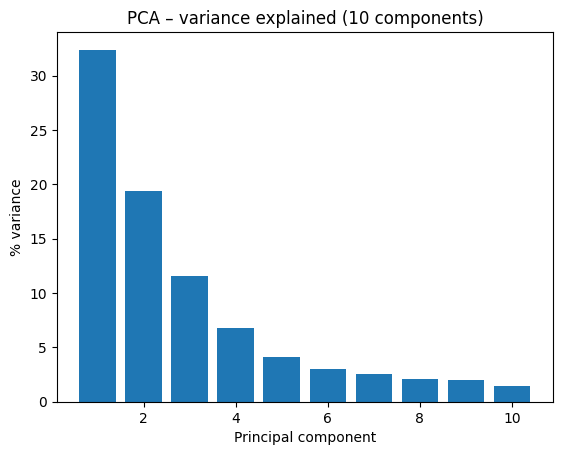

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

plt.bar(range(1, 11), pca.explained_variance_ratio_ * 100)
plt.ylabel("% variance")
plt.xlabel("Principal component")
plt.title("PCA – variance explained (10 components)")
plt.show()


In [ ]:
# Recreate feature names (numeric first, then one-hot):
num_names = ["age_imputed_filled", "Dollar Loss Log",
             "Number of Victims / Nombre de victimes", "loss_present"]
cat_names = pre.transformers_[1][1].get_feature_names_out().tolist()
feat_names = num_names + cat_names

# DataFrame of loadings
loadings = pd.DataFrame(pca.components_.T, index=feat_names,
                        columns=[f"PC{i+1}" for i in range(pca.n_components_)])
# Show top ±5 contributors per PC
for pc in loadings.columns[:5]:
    print(f"\n=== {pc} (explains {pca.explained_variance_ratio_[int(pc[2:])-1]*100:.1f}% var) ===")
    print(loadings[pc].abs().sort_values(ascending=False).head(5))



=== PC1 (explains 32.4% var) ===
loss_present                             58.92%
Dollar Loss Log                          57.92%
Number of Victims / Nombre de victimes   44.78%
Complaint Type_Attempt                   20.16%
Complaint Type_Victim                    20.16%
Name: PC1, dtype: float64

=== PC2 (explains 19.4% var) ===
Number of Victims / Nombre de victimes   51.63%
age_imputed_filled                       50.57%
Dollar Loss Log                          31.04%
loss_present                             29.09%
Solicitation Method_Other/unknown        28.40%
Name: PC2, dtype: float64

=== PC3 (explains 11.6% var) ===
age_imputed_filled                       84.77%
Number of Victims / Nombre de victimes   37.43%
Complaint Type_Attempt                   16.85%
Complaint Type_Victim                    16.85%
loss_present                             14.23%
Name: PC3, dtype: float64

=== PC4 (explains 6.8% var) ===
Gender_Male                              70.24%
Gender_Female      

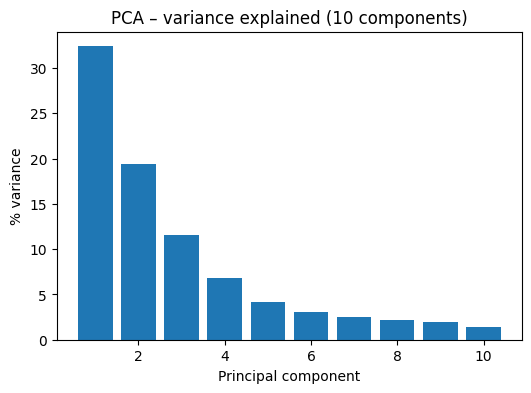

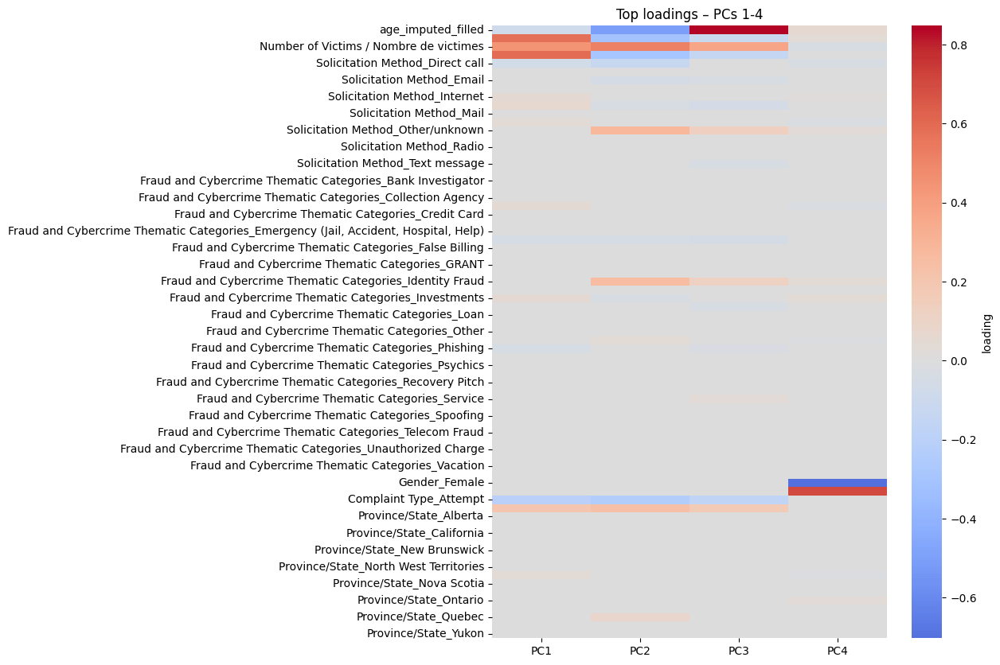

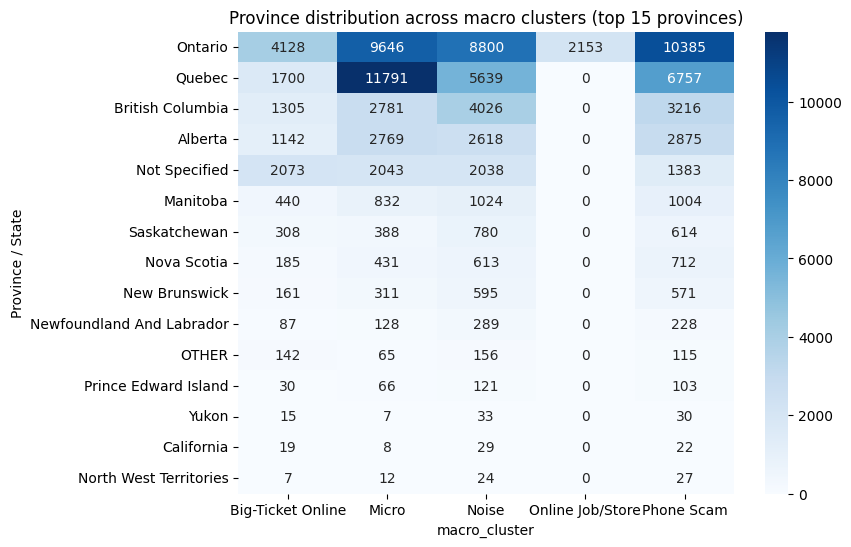

✅ All visualisations generated.


In [ ]:
"""
Comprehensive visual dashboard of our unsupervised analysis
Assumes the following objects are already in memory:

df_f         – labelled DataFrame
embed        – UMAP 2‑D numpy array
X_p          – PCA matrix (n×10)
pca          – fitted PCA object
"""

# Imports
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np



# ------------------------------------------------------------------
# 2️⃣  PCA scatter (PC1 vs PC2) coloured by macro cluster
# ------------------------------------------------------------------
fig_pca = px.scatter(
    x       = X_p[:, 0],
    y       = X_p[:, 1],
    color   = df_f["macro_cluster"],
    labels  = dict(x="PC1", y="PC2"),
    title   = "PCA components 1 vs 2 – coloured by macro cluster",
    opacity = 0.5,
    height  = 550
)
fig_pca.show()

# ------------------------------------------------------------------
# 3️⃣  Explained‑variance bar chart
# ------------------------------------------------------------------
plt.figure(figsize=(6,4))
plt.bar(range(1, 11), pca.explained_variance_ratio_ * 100)
plt.ylabel("% variance")
plt.xlabel("Principal component")
plt.title("PCA – variance explained (10 components)")
plt.show()

# ------------------------------------------------------------------
# 4️⃣  Loadings heatmap (top ± features for PC1‑PC4)
# ------------------------------------------------------------------
# gather feature names
num_names = ["age_imputed_filled", "Dollar Loss Log",
             "Number of Victims / Nombre de victimes", "loss_present"]
cat_names = pre.transformers_[1][1].get_feature_names_out().tolist()
feat_names = num_names + cat_names

load_df = pd.DataFrame(pca.components_[:4].T,   # first 4 PCs
                       index=feat_names,
                       columns=[f"PC{i+1}" for i in range(4)])
# keep 15 highest‑magnitude loadings per PC
mask = (load_df.abs()
        .apply(lambda col: col >= col.abs().nlargest(15).min(), axis=0))
plt.figure(figsize=(8,10))
sns.heatmap(load_df.where(mask).fillna(0), cmap="coolwarm", center=0,
            cbar_kws={"label":"loading"})
plt.title("Top loadings – PCs 1‑4")
plt.show()

# ------------------------------------------------------------------
# 5️⃣  Boxplot of $‑loss by macro cluster (log‑y)
# ------------------------------------------------------------------
fig_box = px.box(df_f, x="macro_cluster", y="Dollar Loss",
                 log_y=True, title="Dollar loss distribution by macro cluster",
                 labels={"macro_cluster":"Cluster"})
fig_box.show()

# ------------------------------------------------------------------
# 6️⃣  Stacked bar – gender split per macro cluster
# ------------------------------------------------------------------
gender_counts = (df_f.groupby(["macro_cluster","Gender"])
                      .size()
                      .reset_index(name="count"))
fig_gender = px.bar(gender_counts, x="macro_cluster", y="count", color="Gender",
                    title="Gender distribution within macro clusters",
                    text_auto=True)
fig_gender.show()

# ------------------------------------------------------------------
# 7️⃣  Province vs macro cluster heatmap (top provinces)
# ------------------------------------------------------------------
top_provs = df_f["Province/State"].value_counts().head(15).index
pivot = (pd.crosstab(df_f["Province/State"], df_f["macro_cluster"])
           .loc[top_provs])
plt.figure(figsize=(8,6))
sns.heatmap(pivot, cmap="Blues", annot=True, fmt="d")
plt.title("Province distribution across macro clusters (top 15 provinces)")
plt.ylabel("Province / State")
plt.show()

# ------------------------------------------------------------------
# 8️⃣  Timeline: monthly incident counts per macro cluster
# ------------------------------------------------------------------
if "Date" in df_f.columns:
    df_f["Month"] = pd.to_datetime(df_f["Date"]).dt.to_period("M")
    monthly = (df_f.groupby(["Month","macro_cluster"])
                    .size().reset_index(name="count"))
    fig_time = px.line(monthly, x="Month", y="count", color="macro_cluster",
                       title="Monthly volume per macro cluster")
    fig_time.update_xaxes(title="")
    fig_time.show()

print("✅ All visualisations generated.")


# "Will they report monetary loss?" classifier


--- Baseline (no macro_cluster) ---
AUC : 0.981
              precision    recall  f1-score   support

           0      0.970     0.938     0.954     15026
           1      0.831     0.913     0.870      4974

    accuracy                          0.932     20000
   macro avg      0.900     0.926     0.912     20000
weighted avg      0.935     0.932     0.933     20000


--- Full (calibrated) ---
AUC : 0.997
              precision    recall  f1-score   support

           0      0.985     0.980     0.983     15026
           1      0.941     0.955     0.948      4974

    accuracy                          0.974     20000
   macro avg      0.963     0.968     0.965     20000
weighted avg      0.974     0.974     0.974     20000


Optimal threshold (train F1-max): 0.473

Full model @ optimal threshold:
              precision    recall  f1-score   support

           0      0.987     0.978     0.983     15026
           1      0.935     0.962     0.949      4974

    accuracy        

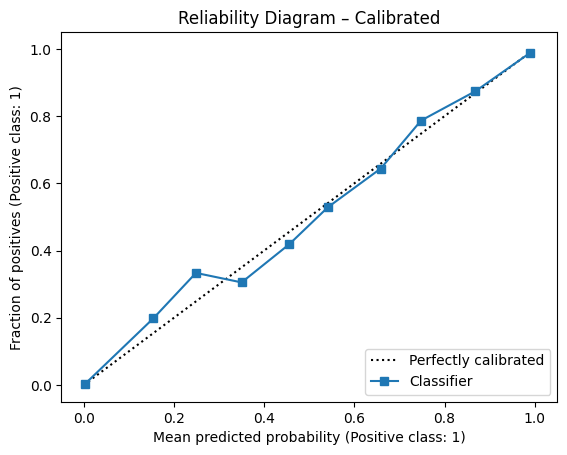

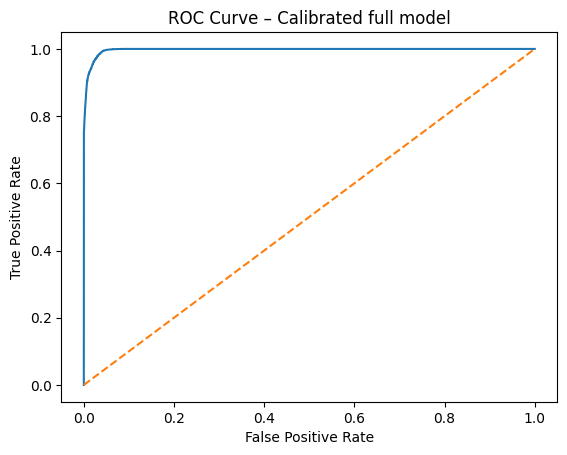

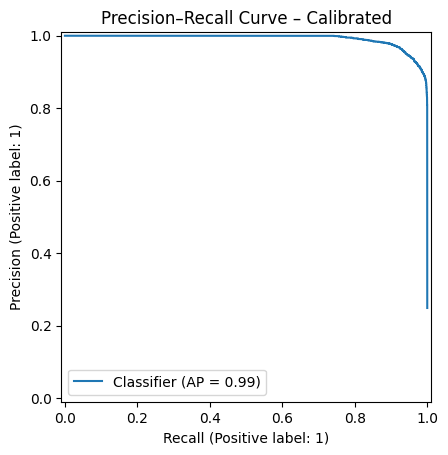

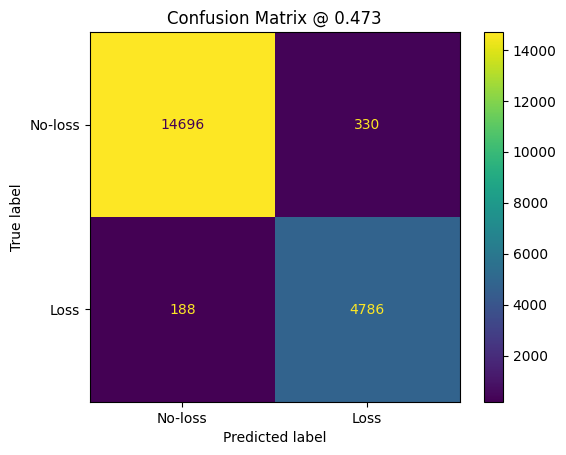


Over-fit check:
Train AUC : 0.998
Test  AUC : 0.997

✅  Saved model_assets/loss_risk_model_calibrated.joblib
✅  Saved model_assets/onehot_columns.json
✅  Saved model_assets/decision_threshold.json


In [ ]:
# ============================================================
#   COMPREHENSIVE CLASSIFIER SECTION  –  ONE CELL
#   • Baseline vs calibrated full model
#   • Threshold tuning, diagnostics, persistence
# ============================================================

import json, joblib, numpy as np, pandas as pd, matplotlib.pyplot as plt
from pathlib import Path
from sklearn.model_selection import train_test_split
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.calibration import CalibratedClassifierCV, CalibrationDisplay
from sklearn.metrics import (
    roc_auc_score, classification_report, precision_recall_curve,
    roc_curve, PrecisionRecallDisplay,
    confusion_matrix, ConfusionMatrixDisplay
)

# ─────────────────────────────────────────────────────────────
# 0️⃣  LOAD LABELLED DATAFRAME  (edit path if needed)
# ─────────────────────────────────────────────────────────────
if "df_f" not in globals():
    df_path = Path("checkpoint") / "cafa_checkpoint_20250517_2205_labelled.feather"
    df_f = pd.read_feather(df_path)
    print(f"Loaded df_f from {df_path} with {len(df_f):,} rows")

# ─────────────────────────────────────────────────────────────
# 1️⃣  FEATURE MATRICES
# ─────────────────────────────────────────────────────────────
full_feats = [
    "age_imputed_filled",
    "Number of Victims / Nombre de victimes",
    "Gender", "Province/State",
    "Fraud and Cybercrime Thematic Categories",
    "Solicitation Method",
    "macro_cluster"
]
base_feats = full_feats[:-1]           # drop persona for baseline

X_full = pd.get_dummies(df_f[full_feats], drop_first=False)
X_base = pd.get_dummies(df_f[base_feats], drop_first=False)
y      = df_f["loss_present"]

# save column order for future scoring
Path("model_assets").mkdir(exist_ok=True)
with open("model_assets/onehot_columns.json", "w") as f:
    json.dump(list(X_full.columns), f)

# ─────────────────────────────────────────────────────────────
# 2️⃣  HOLD-OUT SPLIT  (80 / 20)
# ─────────────────────────────────────────────────────────────
Xf_tr, Xf_te, y_tr, y_te = train_test_split(
    X_full, y, test_size=0.20, stratify=y, random_state=42
)
Xb_tr, Xb_te, _, _ = train_test_split(
    X_base, y, test_size=0.20, stratify=y, random_state=42
)

# ─────────────────────────────────────────────────────────────
# 3️⃣  BASELINE  (no persona)
# ─────────────────────────────────────────────────────────────
mdl_base = HistGradientBoostingClassifier(
    max_iter=200, learning_rate=0.1, random_state=42
).fit(Xb_tr, y_tr)

# ─────────────────────────────────────────────────────────────
# 4️⃣  FULL MODEL  (best params)  +  ISOTONIC CALIBRATION
# ─────────────────────────────────────────────────────────────
best_params = dict(max_iter=200, learning_rate=0.05, random_state=42)
raw_clf = HistGradientBoostingClassifier(**best_params).fit(Xf_tr, y_tr)

cal_clf = CalibratedClassifierCV(raw_clf, cv=5, method="isotonic")
cal_clf.fit(Xf_tr, y_tr)

# ─────────────────────────────────────────────────────────────
# 5️⃣  EVALUATION  (threshold 0.5)
# ─────────────────────────────────────────────────────────────
def eval_model(model, X, y, label):
    prob = model.predict_proba(X)[:,1]
    pred = (prob >= 0.5).astype(int)
    print(f"\n--- {label} ---")
    print(f"AUC : {roc_auc_score(y, prob):.3f}")
    print(classification_report(y, pred, digits=3))

eval_model(mdl_base, Xb_te, y_te, "Baseline (no macro_cluster)")
eval_model(cal_clf, Xf_te, y_te, "Full (calibrated)")

# ─────────────────────────────────────────────────────────────
# 6️⃣  THRESHOLD TUNING (max F1 on training)
# ─────────────────────────────────────────────────────────────
p_tr = cal_clf.predict_proba(Xf_tr)[:,1]
prec, rec, thr = precision_recall_curve(y_tr, p_tr)
f1  = 2 * prec * rec / (prec + rec + 1e-9)
opt_thr = thr[np.nanargmax(f1[:-1])]
print(f"\nOptimal threshold (train F1-max): {opt_thr:.3f}")

p_te = cal_clf.predict_proba(Xf_te)[:,1]
y_te_pred = (p_te >= opt_thr).astype(int)
print("\nFull model @ optimal threshold:")
print(classification_report(y_te, y_te_pred, digits=3))

# ─────────────────────────────────────────────────────────────
# 7️⃣  DIAGNOSTIC PLOTS
# ─────────────────────────────────────────────────────────────
# ROC
fpr, tpr, _ = roc_curve(y_te, p_te)
CalibrationDisplay.from_predictions(y_te, p_te, n_bins=10)
plt.title("Reliability Diagram – Calibrated"); plt.show()

plt.figure()
plt.plot(fpr, tpr); plt.plot([0,1],[0,1],'--')
plt.xlabel("False Positive Rate"); plt.ylabel("True Positive Rate")
plt.title("ROC Curve – Calibrated full model"); plt.show()

# PR curve
PrecisionRecallDisplay.from_predictions(y_te, p_te)
plt.title("Precision–Recall Curve – Calibrated"); plt.show()

# Confusion matrix
cm = confusion_matrix(y_te, y_te_pred)
ConfusionMatrixDisplay(cm, display_labels=["No-loss","Loss"]).plot(values_format="d")
plt.title(f"Confusion Matrix @ {opt_thr:.3f}"); plt.show()

# Train vs Test AUC
print("\nOver-fit check:")
print("Train AUC :", round(roc_auc_score(y_tr, p_tr),3))
print("Test  AUC :", round(roc_auc_score(y_te, p_te),3))

# ─────────────────────────────────────────────────────────────
# 8️⃣  SAVE CALIBRATED CLASSIFIER & THRESHOLD
# ─────────────────────────────────────────────────────────────
joblib.dump(cal_clf, "model_assets/loss_risk_model_calibrated.joblib")
with open("model_assets/decision_threshold.json", "w") as f:
    json.dump({"threshold": float(opt_thr)}, f)

print("\n✅  Saved model_assets/loss_risk_model_calibrated.joblib")
print("✅  Saved model_assets/onehot_columns.json")
print("✅  Saved model_assets/decision_threshold.json")


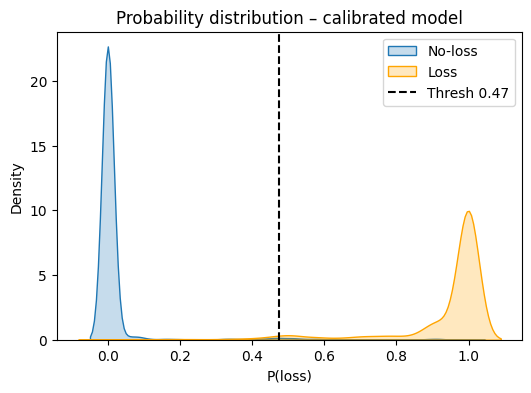

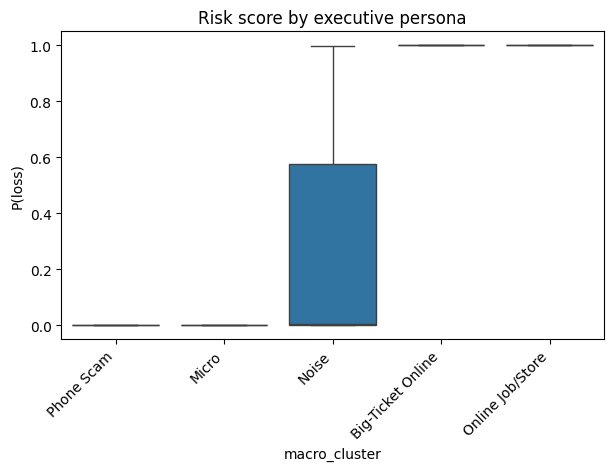

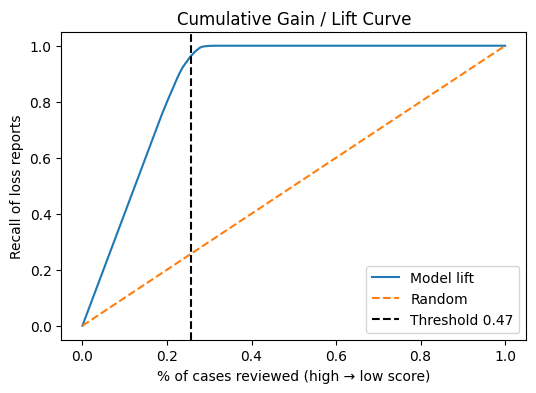

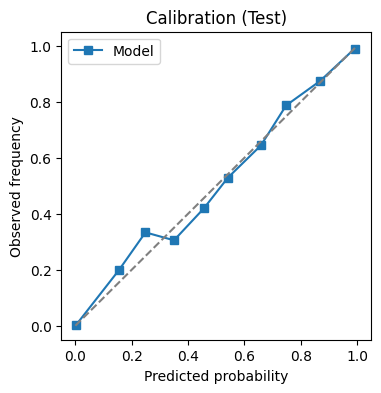

In [ ]:
# ─────────────────────────────────────────────────────────────
#  PROBABILITY SHOWCASE  (run after classifier cell)
# ─────────────────────────────────────────────────────────────
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np, pandas as pd
from sklearn.metrics import roc_auc_score

# 1️⃣  Get probabilities for the hold-out test set
probs = cal_clf.predict_proba(Xf_te)[:,1]
df_vis = df_f.loc[Xf_te.index].copy()
df_vis["prob_loss"] = probs
df_vis["true"]      = y_te.values

# 2️⃣  Histogram / density: score distribution by class
plt.figure(figsize=(6,4))
sns.kdeplot(df_vis.loc[df_vis["true"]==0, "prob_loss"], label="No-loss", shade=True)
sns.kdeplot(df_vis.loc[df_vis["true"]==1, "prob_loss"], label="Loss",   shade=True, color="orange")
plt.axvline(opt_thr, ls="--", color="k", label=f"Thresh {opt_thr:.2f}")
plt.title("Probability distribution – calibrated model")
plt.xlabel("P(loss)")
plt.legend(); plt.show()

# 3️⃣  Box-plot of probabilities by macro persona
plt.figure(figsize=(7,4))
sns.boxplot(x="macro_cluster", y="prob_loss", data=df_vis, showfliers=False)
plt.xticks(rotation=45, ha="right")
plt.title("Risk score by executive persona")
plt.ylabel("P(loss)"); plt.show()

# 4️⃣  Lift / cumulative gain curve
df_gain = df_vis.sort_values("prob_loss", ascending=False).reset_index(drop=True)
df_gain["cum_pos"] = df_gain["true"].cumsum()
total_pos = df_gain["true"].sum()
df_gain["pct_cases"] = (df_gain.index+1)/len(df_gain)
df_gain["recall"] = df_gain["cum_pos"] / total_pos

plt.figure(figsize=(6,4))
plt.plot(df_gain["pct_cases"], df_gain["recall"], label="Model lift")
plt.plot([0,1],[0,1], ls="--", label="Random")
plt.axvline(df_gain[df_gain["prob_loss"]>=opt_thr]["pct_cases"].max(), color="k", ls="--",
            label=f"Threshold {opt_thr:.2f}")
plt.xlabel("% of cases reviewed (high → low score)")
plt.ylabel("Recall of loss reports")
plt.title("Cumulative Gain / Lift Curve")
plt.legend(); plt.show()

# 5️⃣  Reliability diagram (again, but on test)
from sklearn.calibration import calibration_curve
prob_true, prob_pred = calibration_curve(y_te, probs, n_bins=10)
plt.figure(figsize=(4,4))
plt.plot(prob_pred, prob_true, "s-", label="Model")
plt.plot([0,1],[0,1], "--", color="gray")
plt.xlabel("Predicted probability"); plt.ylabel("Observed frequency")
plt.title("Calibration (Test)")
plt.legend(); plt.show()


# Dollar Loss Amount Predictor

In [ ]:
# Filter to rows that actually incurred loss
df_loss = df_f[df_f["Dollar Loss"] > 0].copy()
df_loss["loss_log"] = np.log1p(df_loss["Dollar Loss"])

# Reuse the same feature set
X_reg = pd.get_dummies(df_loss[full_feats], drop_first=False)
y_reg = df_loss["loss_log"]

from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score

X_tr, X_te, y_tr, y_te = train_test_split(
    X_reg, y_reg, test_size=0.2, random_state=42
)

reg = HistGradientBoostingRegressor(max_iter=300, learning_rate=0.05, random_state=42)
reg.fit(X_tr, y_tr)

pred_log = reg.predict(X_te)
mae  = mean_absolute_error(y_te, pred_log)
r2   = r2_score(y_te, pred_log)
print(f"MAE (log-loss): {mae:.3f},  R²: {r2:.3f}")

# Convert back to dollars if you like
pred_dollars = np.expm1(pred_log)


MAE (log-loss): 1.192,  R²: 0.551


Regression rows: 24,868
Best params: {'learning_rate': 0.1, 'max_depth': None}

─ Performance on TEST ─
MAE (log-space)    : 1.190
RMSE (log-space)   : 1.639
R²                 : 0.552
MAE ($)            : $23,178
RMSE ($)           : $133,042
Median APE         : 73.0%


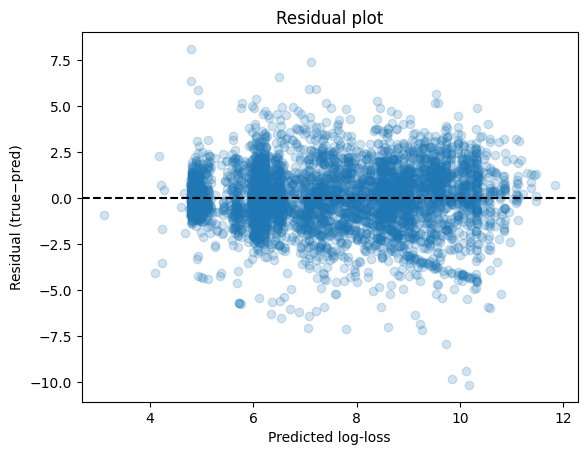

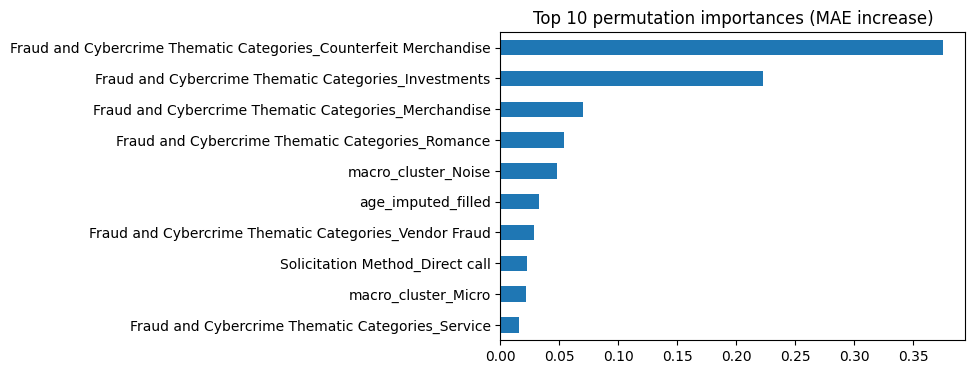


✅  Saved loss_amount_regressor.joblib and onehot_columns.json


In [ ]:
# ============================================================
#  STAGE-B  –  Dollar-loss regression on positive-loss rows
# ============================================================

import pandas as pd, numpy as np, json, joblib, matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.metrics import (
    mean_absolute_error, mean_squared_error, r2_score
)
from sklearn.inspection import permutation_importance

# ─── 1. Keep only rows with non-zero loss ─────────────────────
df_loss = df_f[df_f["Dollar Loss"] > 0].copy()
df_loss["loss_log"] = np.log1p(df_loss["Dollar Loss"])

print(f"Regression rows: {len(df_loss):,}")

# ─── 2. Feature set (same as classifier) ──────────────────────
feature_cols = [
    "age_imputed_filled",
    "Number of Victims / Nombre de victimes",
    "Gender",
    "Province/State",
    "Fraud and Cybercrime Thematic Categories",
    "Solicitation Method",
    "macro_cluster"          # persona label
]

X_all = pd.get_dummies(df_loss[feature_cols], drop_first=False)
y_all = df_loss["loss_log"]

# save column order for deployment
with open("onehot_columns.json", "w") as f:
    json.dump(list(X_all.columns), f)

# ─── 3. Train / test split (80 / 20) ──────────────────────────
X_train, X_test, y_train, y_test = train_test_split(
    X_all, y_all, test_size=0.2, random_state=42
)

# ─── 4. Grid-search hyper-params with 5-fold CV ───────────────
param_grid = {
    "learning_rate": [0.05, 0.1],
    "max_depth": [None, 6, 4]
}
cv = KFold(n_splits=5, shuffle=True, random_state=42)
gbr = HistGradientBoostingRegressor(max_iter=400, random_state=42)

gs = GridSearchCV(
    gbr, param_grid,
    cv=cv,
    scoring="neg_mean_absolute_error",
    n_jobs=-1
).fit(X_train, y_train)

print("Best params:", gs.best_params_)
reg = gs.best_estimator_

# ─── 5. Evaluation on hold-out test ───────────────────────────
y_pred_log = reg.predict(X_test)
y_pred     = np.expm1(y_pred_log)
y_true     = np.expm1(y_test)

mae_log  = mean_absolute_error(y_test, y_pred_log)
rmse_log = np.sqrt(mean_squared_error(y_test, y_pred_log))
r2       = r2_score(y_test, y_pred_log)

mae_dol  = mean_absolute_error(y_true, y_pred)
rmse_dol = np.sqrt(mean_squared_error(y_true, y_pred))
mape     = np.median(np.abs((y_true - y_pred) / y_true)) * 100


print("\n─ Performance on TEST ─")
print(f"MAE (log-space)    : {mae_log:.3f}")
print(f"RMSE (log-space)   : {rmse_log:.3f}")
print(f"R²                 : {r2:.3f}")
print(f"MAE ($)            : ${mae_dol:,.0f}")
print(f"RMSE ($)           : ${rmse_dol:,.0f}")
print(f"Median APE         : {mape:.1f}%")

# Residual plot
plt.scatter(y_pred_log, y_test - y_pred_log, alpha=0.2)
plt.axhline(0, color="k", ls="--")
plt.xlabel("Predicted log-loss")
plt.ylabel("Residual (true−pred)")
plt.title("Residual plot")
plt.show()

# ─── 6. Permutation importances (top 10) ──────────────────────
perm = permutation_importance(
    reg, X_test, y_test,
    n_repeats=5, random_state=42, n_jobs=-1
)
imp = pd.Series(perm.importances_mean, index=X_all.columns)
plt.figure(figsize=(6,4))
imp.nlargest(10)[::-1].plot(kind="barh")
plt.title("Top 10 permutation importances (MAE increase)")
plt.show()

# ─── 7. Persist regressor for later use ───────────────────────
joblib.dump(reg, "loss_amount_regressor.joblib")
print("\n✅  Saved loss_amount_regressor.joblib and onehot_columns.json")
